***
# **EDA** 

### *Bike Availability Prediction*

##### *Cleofe Pena, Albert Ventura, Arnau Aumedes*

***

The Exploratory Data Analysis consisted in two parts. One part more **"ANALYTIC"**, where we explored different patterns of the data, and another part we focused on the **BARCELONA MAP**.

### Libraries and loading data

In [1]:
# DATA PATH HERE
folder_path = '..\\AUXILIARY_DATA_DFS' # YOUR_PATH/AUXILIARY_DATA_DFS
#Uncoment if you are in google colab, and your data is google drive
#from google.colab import drive
#drive.mount('/content/drive')

In [5]:
import numpy as np
import pandas as pd
import os
import seaborn as sns
from scipy import stats
import sklearn
# %matplotlib inline
import matplotlib as mpl
import matplotlib.pyplot as plt
import xgboost as xgb

# **EDA "ANALYTICS"** 

***

In [6]:
df_all_docks = pd.read_csv(os.path.join(folder_path, 'bicing_dataset_docks_v02.csv') )
metadata_sample_submissison = pd.read_csv(os.path.join(folder_path,'metadata_sample_submission.csv'))

In [7]:
df_all_docks['last_reported'] = pd.to_datetime(df_all_docks['last_reported'], utc=True)
df_all_docks['dayofyear'] = df_all_docks['last_reported'].dt.dayofyear
df_all_docks['dayofweek'] = df_all_docks['last_reported'].dt.dayofweek

### Time-Related Patterns by hour/day/month

Looking at the number of docks available hourly, daily, monthly. we found i) a very stable pattern hourly across all the years, ii) a very similar pattern monthly in years 2021-2022 vs years 2019-2020, and iii) a non-clear daily pattern across the years.

In [8]:
years = [2019,2020,2021,2022]

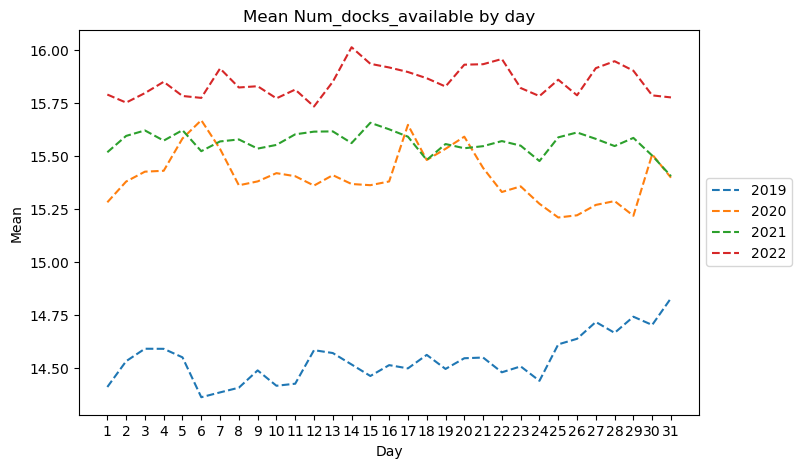

In [9]:
plt.figure(figsize=(8, 5))
days_by_year =[]
for YEAR in years:
    G = df_all_docks[(df_all_docks['year']==YEAR)].groupby(['day'])['num_docks_available'].mean()
    days_by_year.append(G)
    #plt.figure(figsize=(8, 5))
    plt.plot(np.asarray(G.index),np.asarray(G.values),linestyle='dashed',label = YEAR)
    plt.xlabel('Day')
    plt.ylabel('Mean')
    plt.title(f'Mean Num_docks_available by day')
    #plt.legend(loc='upper left')
    plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    plt.xticks(np.asarray(G.index))

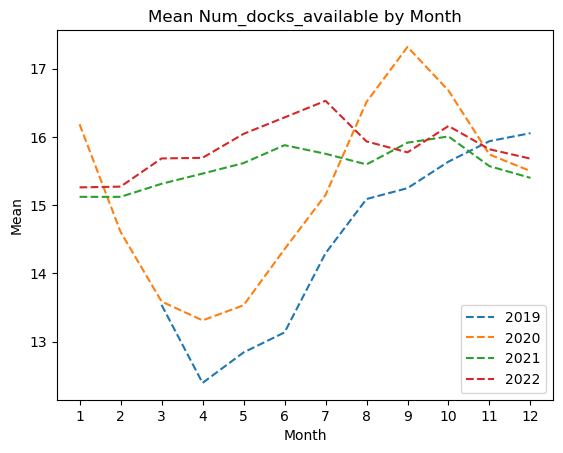

In [11]:
for YEAR in years:
    G = df_all_docks[(df_all_docks['year']==YEAR)].groupby(['month'])['num_docks_available'].mean()
    plt.plot(np.asarray(G.index),np.asarray(G.values),linestyle='dashed',label = YEAR)
    plt.xlabel('Month')
    plt.ylabel('Mean')
    plt.title(f'Mean Num_docks_available by Month')
    plt.legend(loc='lower right')
    plt.xticks(np.asarray(G.index))

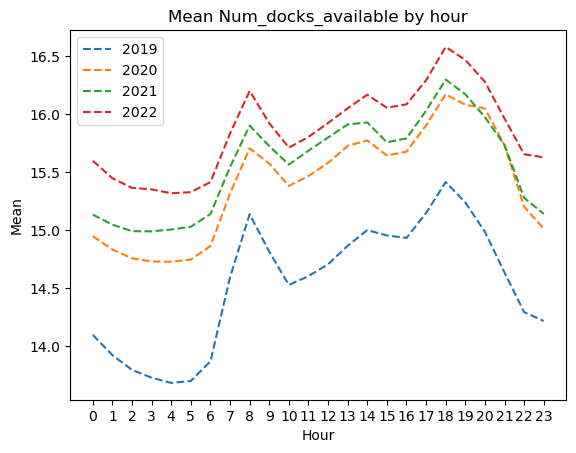

In [12]:
for YEAR in years:
    G = df_all_docks[(df_all_docks['year']==YEAR)].groupby(['hour'])['num_docks_available'].mean()
    plt.plot(np.asarray(G.index),np.asarray(G.values),linestyle='dashed',label = YEAR)
    plt.xlabel('Hour')
    plt.ylabel('Mean')
    plt.title(f'Mean Num_docks_available by hour')
    plt.legend(loc='upper left')
    plt.xticks(np.asarray(G.index))

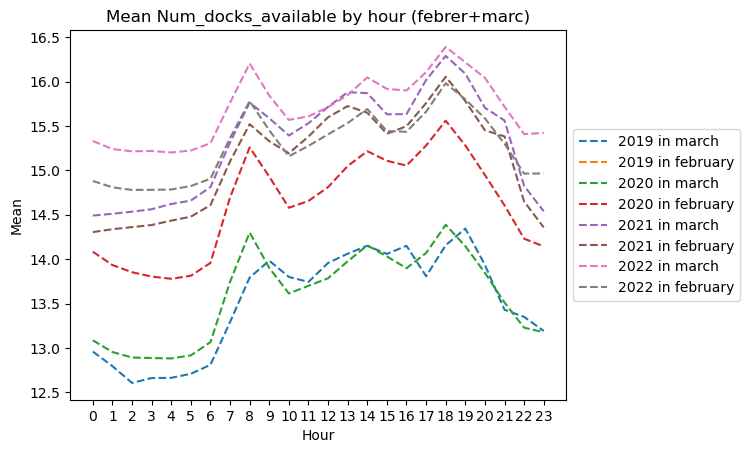

In [13]:
for YEAR in years:
    G = df_all_docks[(df_all_docks['year']==YEAR) &  (df_all_docks['month']==2)].groupby(['hour'])['num_docks_available'].mean()
    G2 =df_all_docks[(df_all_docks['year']==YEAR) &  (df_all_docks['month']==3)].groupby(['hour'])['num_docks_available'].mean()
    plt.plot(np.asarray(G2.index),np.asarray(G2.values),linestyle='dashed',label =f"{YEAR} in march"    )
    plt.plot(np.asarray(G.index),np.asarray(G.values),linestyle='dashed',label =  f"{YEAR} in february" )
    plt.xlabel('Hour')
    plt.ylabel('Mean')
    plt.title(f'Mean Num_docks_available by hour (febrer+marc)')
    #plt.legend(loc='upper left')
    plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    plt.xticks(np.asarray(G.index))

It is observed a that the summer months there is much more available docks than in the rest of the months, this can be observed in the heatmap below (month-hour). In addition, we provide the visualization month-day.

In [ ]:
DATA_PATH = Path('../data/raw_data')
DATA_FILENAMES = os.listdir(DATA_PATH)
df = pd.read_csv('../datasets/train_dataset.csv')
TARGET = 'percentage_docks_available'


def month_to_season(row):
    if row.month in [12,1,2]:
        return 'winter'
    elif row.month in [3, 4, 5]:
        return 'spring'
    elif row.month in [6,7,8]:
        return 'summer'
    elif row.month in [9,10,11]:
        return 'fall'
    else:
        raise ValueError('value outside of range 1-12')

In [ ]:
df['season'] = df.apply(month_to_season, axis = 1)

In [ ]:
df['last_reported'] = pd.to_datetime(df.last_reported, utc = True)

In [ ]:
df.groupby(['station_id', 'hour']).num_bikes_available.agg(['mean', 'std']).reset_index()

,station_id,hour,mean,std
0,1,0.0,21.912873,9.916086
1,1,1.0,24.696371,9.791155
2,1,2.0,21.964624,8.450437
3,1,3.0,25.714535,8.831115
4,1,4.0,24.772004,9.136590
...,...,...,...,...
9307,496,19.0,4.976782,4.013178
9308,496,20.0,5.937404,4.365784
9309,496,21.0,8.200481,4.256920
9310,496,22.0,9.093537,4.536118


In [ ]:
def heatmap_by_year(df, group, column_data, xlabel, ylabel, columns = None, vertical = True):
    """
    Function that aggregates data appropriately to display a heatmap for 2020, 2021 and 2022
    """

    df_grouped = df.groupby(group)[column_data].mean().unstack().fillna(0)
    data = df_grouped.to_numpy()
    data /= data.max()
    if vertical:
        fig, axs = plt.subplots(3,1,figsize = (6,12), sharex= True)
    else:
        fig, axs = plt.subplots(1,3,figsize = (18,6), sharey=True)
    
    for ax, year in zip(axs, [2020, 2021, 2022]):
        
        df_grouped = df[df.year == year].groupby(group)[column_data].mean().unstack().fillna(0)
        data = df_grouped.to_numpy()
        data /= data.max()
    
        g = ax.imshow(df_grouped, cmap = 'RdBu')
        ax.set_xlabel(xlabel)
        ax.set_ylabel(ylabel)
        if columns is not None:
            ax.set_xticks(range(len(columns)))
            ax.set_xticklabels(columns, rotation = -45)
        ax.set_title(year)
        cax = fig.add_axes([ax.get_position().x1 + 0.001, ax.get_position().y0, 0.02, ax.get_position().height])
        fig.colorbar(g, cax = cax)
        ax.grid(None)

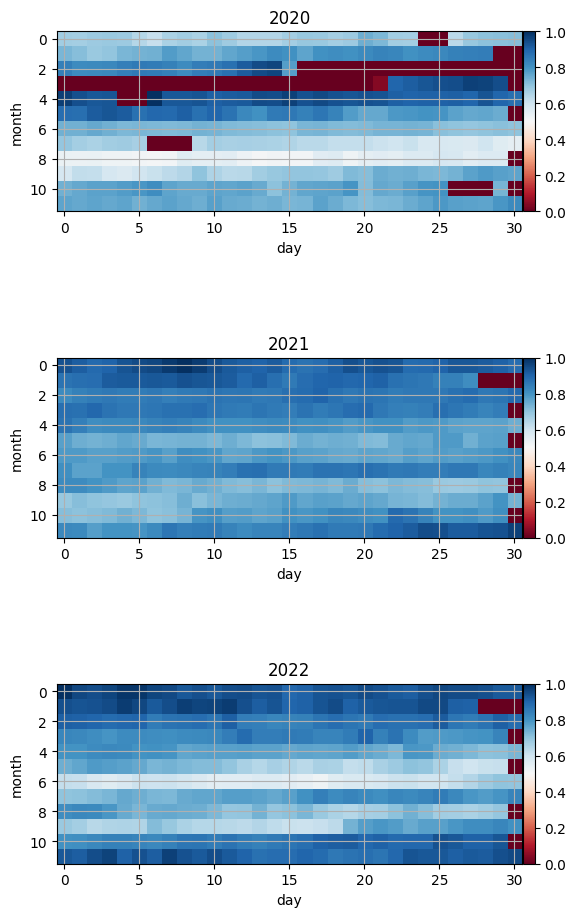

In [ ]:
heatmap_by_year(df, ['month', 'day'], TARGET, 'day', 'month')

The hourly pattern across all years seems to follow a typical "workday", with peaks at 8-9 a.m. and 18 p.m. when people go and leave work, respectively. Below we also provide a heatmap, grouping by day-hour, where this pattern can be observed.

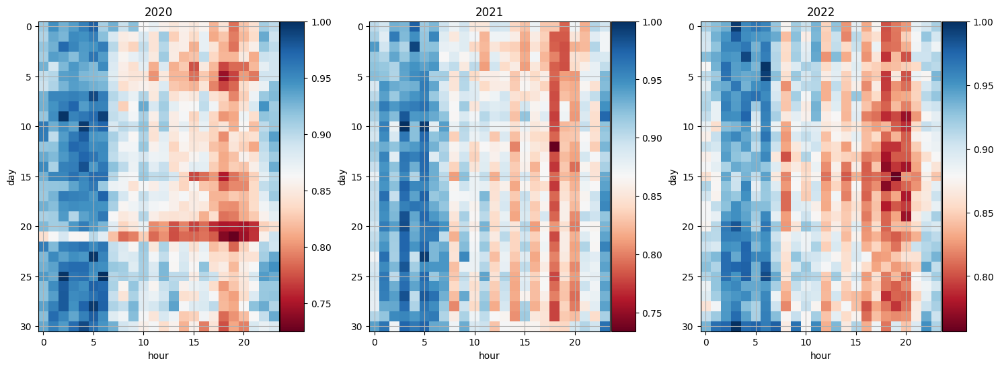

In [ ]:
heatmap_by_year(df, ['day', 'hour'], TARGET, 'hour', 'day', vertical=False)

In contrast the daily pattern is not clear provided above, probably because there is not alignment between the days as in it is the case for the hourly pattern. Probably a weekday aggrupation will be better, as we provide below:

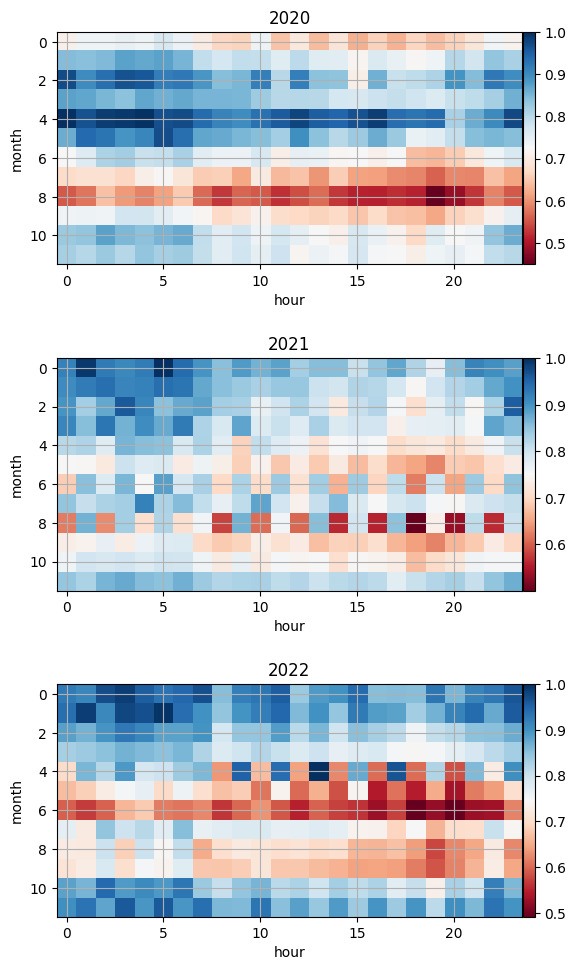

In [ ]:
heatmap_by_year(df, ['month', 'hour'], TARGET, 'hour', 'month')

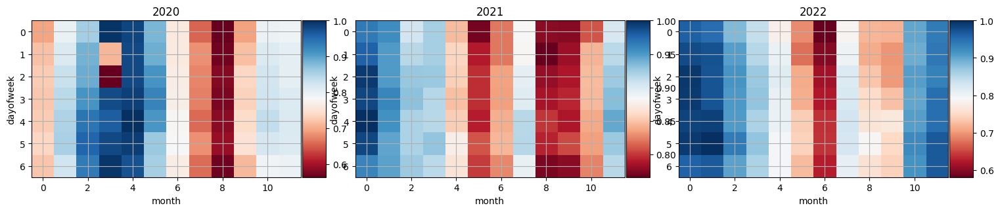

In [ ]:
heatmap_by_year(df, ['dayofweek', 'month'], TARGET, 'month', 'dayofweek', vertical=False)

In general, it seems that years 21-22 are more similar by month than 19-20. The obvious reason is the pandemic struck in 2020. Also, we observe we do not have all the data for the 2019.

### Variables related with target

We also explored the relationship the target variable with other variables. Also, we downloaded the wheatear data that could be associated with the target of study. Some of the weather variables studied were temperature, windspeed, humidity, and rain. Also, we examined the most frequent values using histograms:

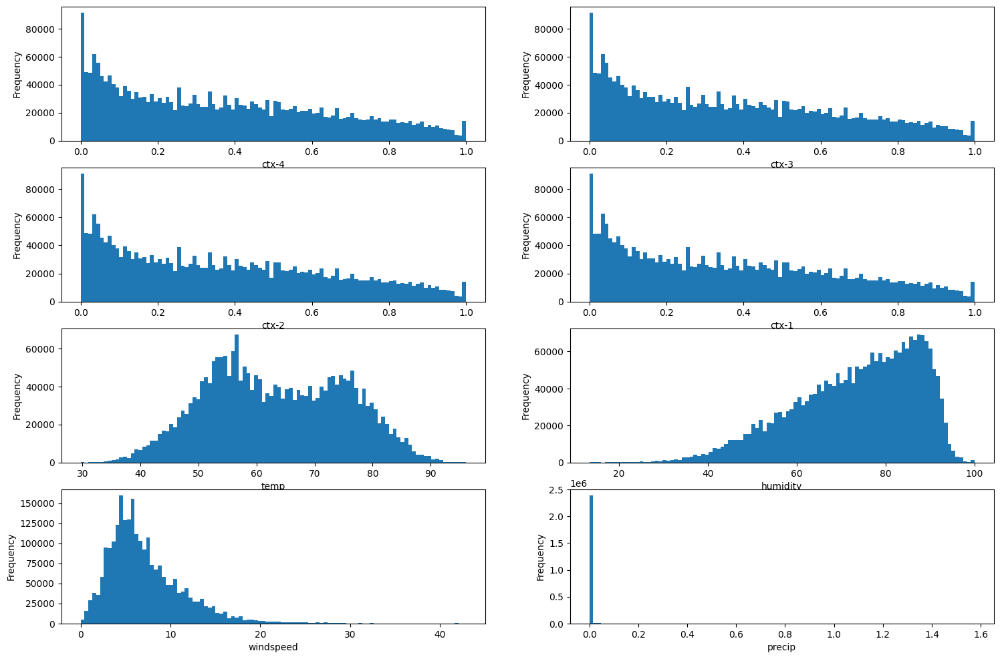

In [ ]:
fig, axs = plt.subplots(4, 2, figsize = (18,12))
axs = axs.flatten()
for col, ax in zip(cont_cols, axs):
    make_histogram(df, col, ax = ax)

We observed that ctx-1, just the hour before, is clearly associated with the target variable and this association is dissipated with time. The weather variables don’t seem to have a clear pattern of association with the target.

### Similarity across stations

Also, we were interested in the similarity of the stations across the years. When looking at the mean of the num of docks by station, we observed, after performing a clustering, one cluster of 21-22, and another of 19-20.

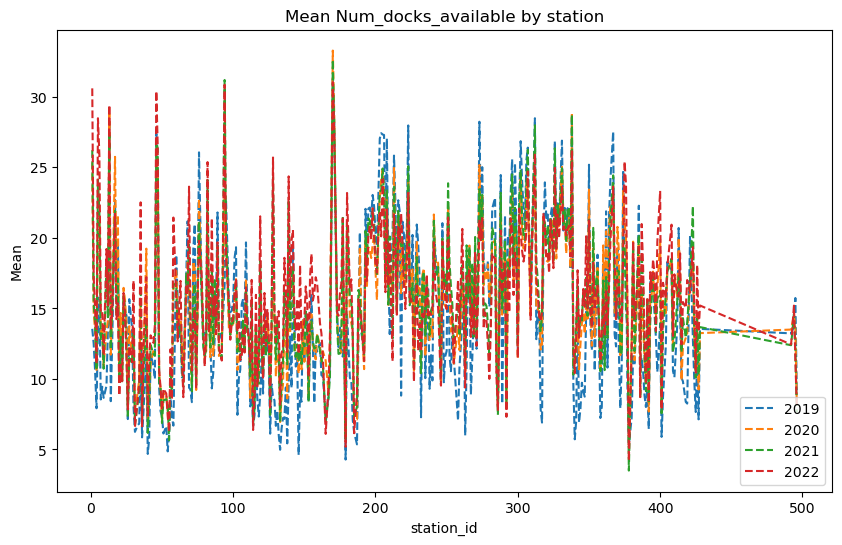

In [14]:
plt.figure(figsize=(10, 6))
stations_years =[]
for YEAR in years:
    G = df_all_docks[(df_all_docks['year']==YEAR)].groupby(['station_id'])['num_docks_available'].mean()
    stations_years.append(G)
    plt.plot(np.asarray(G.index),np.asarray(G.values),linestyle='dashed',label = YEAR)
    plt.xlabel('station_id')
    plt.ylabel('Mean')
    plt.title(f'Mean Num_docks_available by station')
    plt.legend(loc='lower right')
    #plt.xticks(np.asarray(G.index))

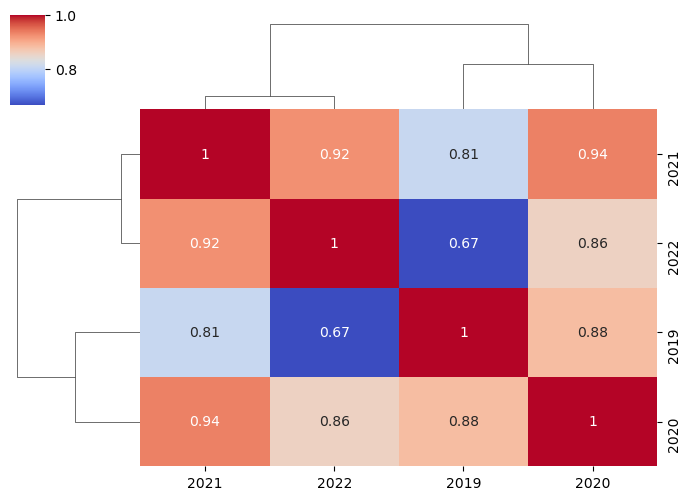

In [15]:
correlation_matrix = np.corrcoef(stations_years)
data = pd.DataFrame(correlation_matrix, columns=['2019', '2020', '2021', '2022'], index=['2019', '2020', '2021', '2022'])
sns.clustermap(data,metric="correlation",cmap="coolwarm",  annot=True, figsize=(7, 5) )

When we look at the histogram of num of docks used:

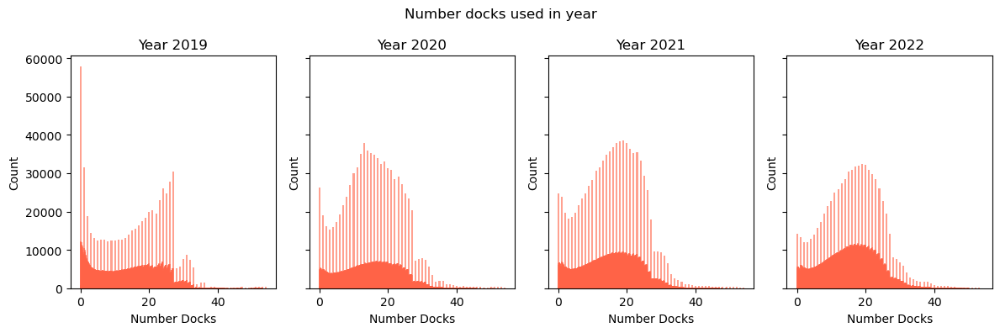

In [16]:
title = 'Number docks used in year'
xlabel = 'Number Docks'
ylabel = 'Count'
years = [2019, 2020, 2021, 2022]

fig, axs = plt.subplots(1, len(years), figsize=(12, 4), sharey=True)  # Create a row of subplots
fig.suptitle(title)

for i, year in enumerate(years):
    data_filt = df_all_docks[df_all_docks['year'] == year]
    ax = axs[i]  # Get the appropriate subplot
    ax.bar(*np.unique(data_filt['num_docks_available'], return_counts=True), color='tomato', alpha=0.6, width=0.5)
    ax.set_title(f'Year {year}')
    ax.set_xlabel(xlabel)
    ax.set_ylabel(ylabel)

plt.tight_layout()
plt.show()

Altogether seem to indicate that 21-22 are very similar. Finally, we perform a heatmap analysis of the different years to visualize the behavior across the days for each year, as this:

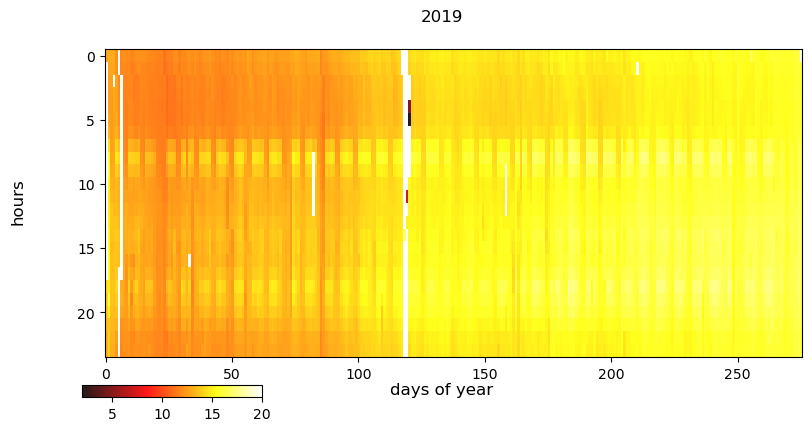

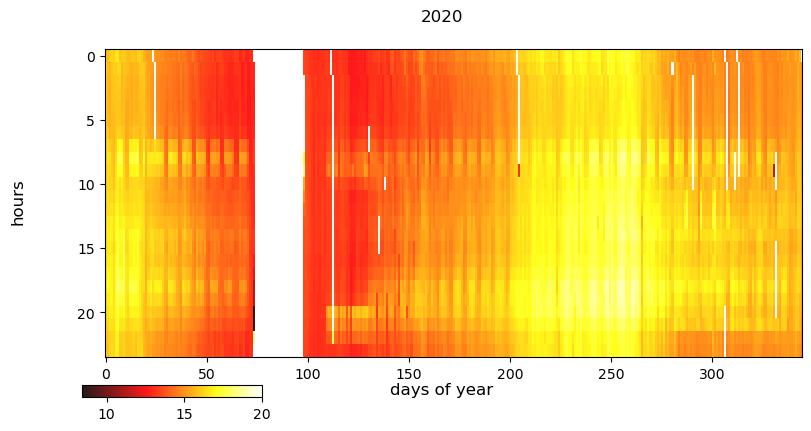

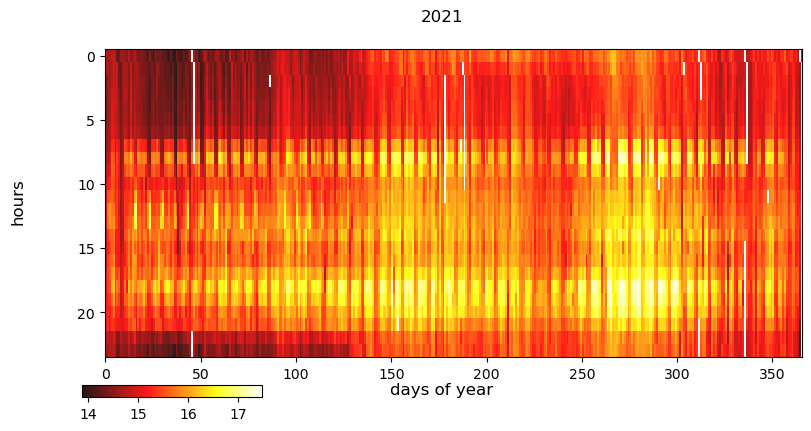

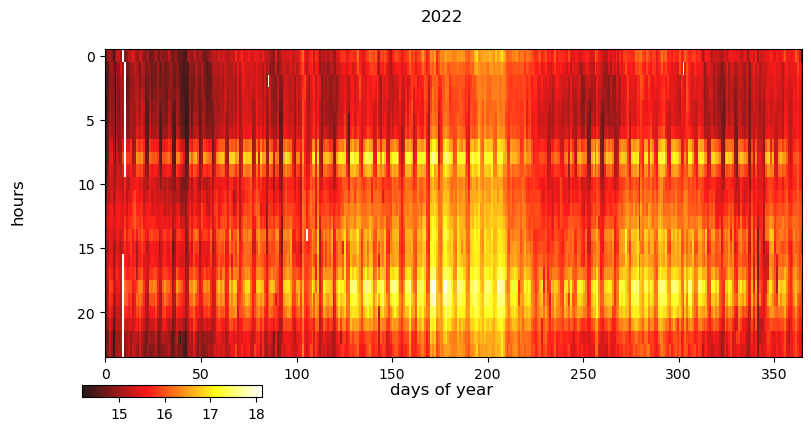

In [17]:
for year in years:
    data_filt = df_all_docks[df_all_docks['year']==year]
    vals = data_filt.groupby(['hour','dayofyear'])['num_docks_available'].mean().unstack().clip(upper=20)
    fig, ax1 = plt.subplots(1, 1, figsize=(9, 4))
    fig.suptitle(year)
    fig.supxlabel('days of year')
    fig.supylabel('hours')
    im = ax1.imshow(vals,cmap=plt.cm.hot,interpolation='nearest', aspect='auto',
                            alpha=.9)
    cax = fig.add_axes([0.1, 0.01, 0.2, 0.03])
    fig.colorbar(im,cax=cax,orientation='horizontal')

We observe i) there are periods of the year that the num of the docks are less available, and ii) there are stations that during the year are very few docks available and vice versa. This indicates to model this accordingly on the ML models.

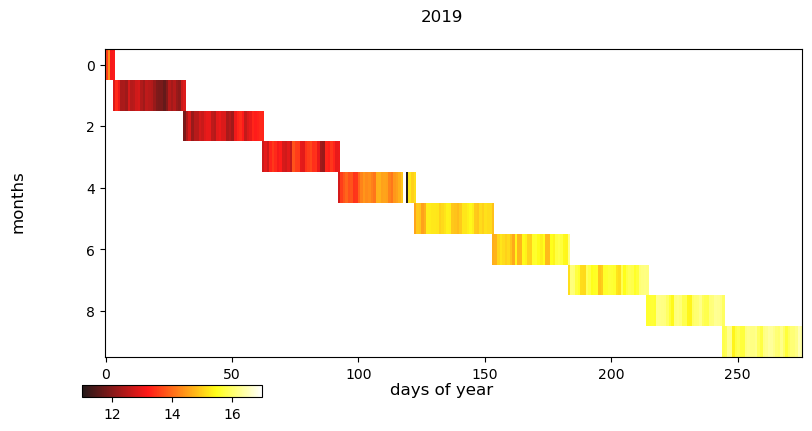

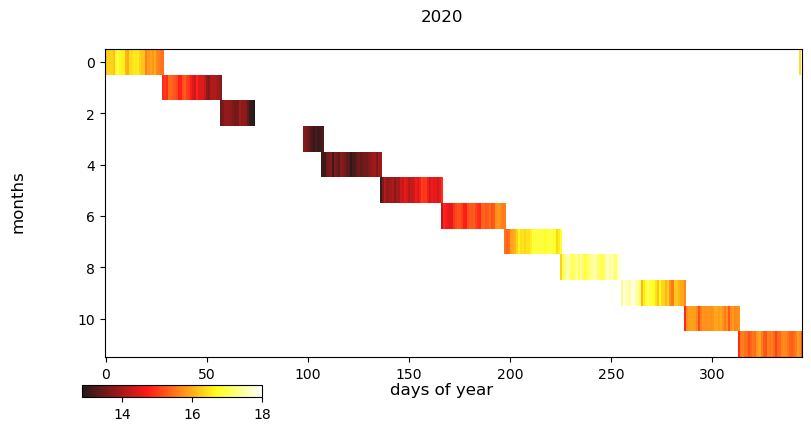

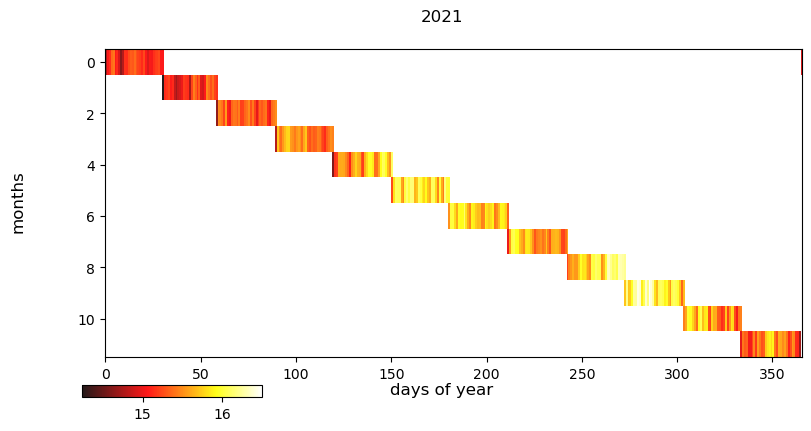

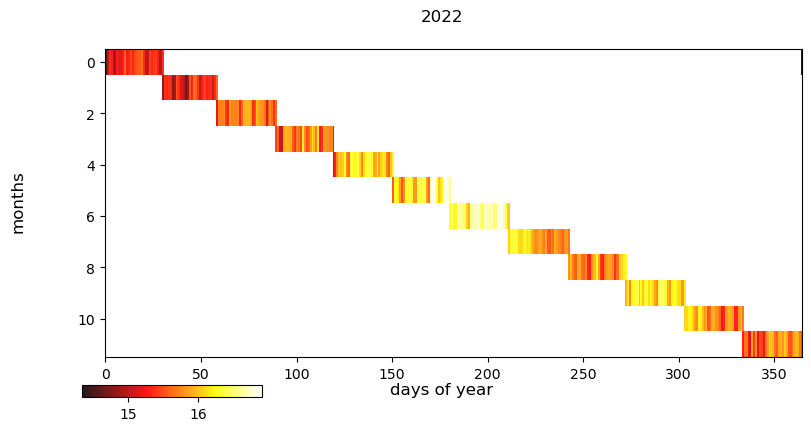

In [18]:
for year in years:
    data_filt = df_all_docks[df_all_docks['year']==year]
    vals = data_filt.groupby(['month','dayofyear'])['num_docks_available'].mean().unstack().clip(upper=18)
    fig, ax1 = plt.subplots(1, 1, figsize=(9, 4))
    fig.suptitle(year)
    fig.supxlabel('days of year')
    fig.supylabel('months')
    im = ax1.imshow(vals,cmap=plt.cm.hot,interpolation='nearest', aspect='auto',
                            alpha=.9)
    cax = fig.add_axes([0.1, 0.01, 0.2, 0.03])
    fig.colorbar(im,cax=cax,orientation='horizontal')

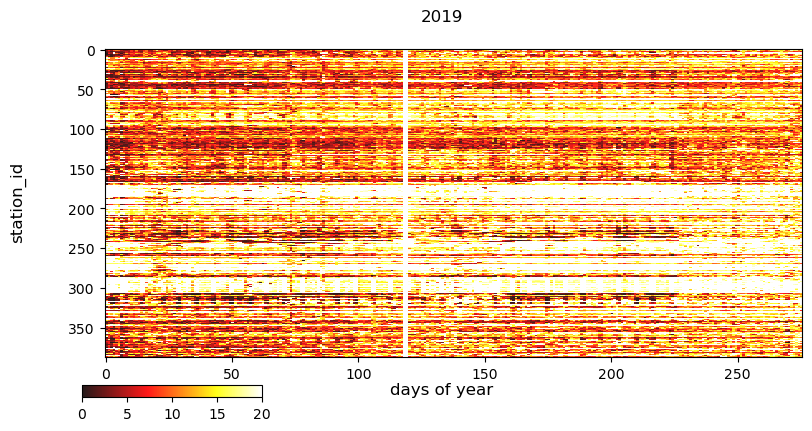

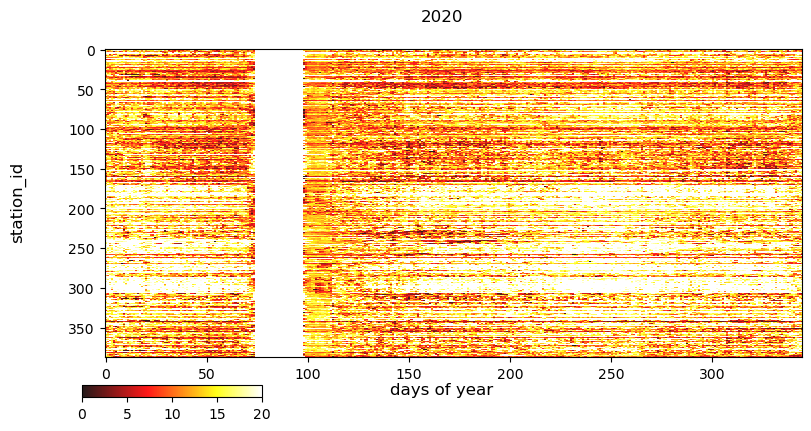

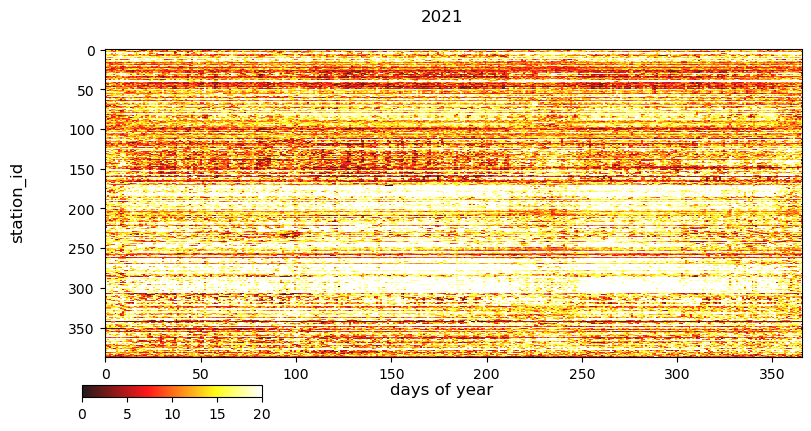

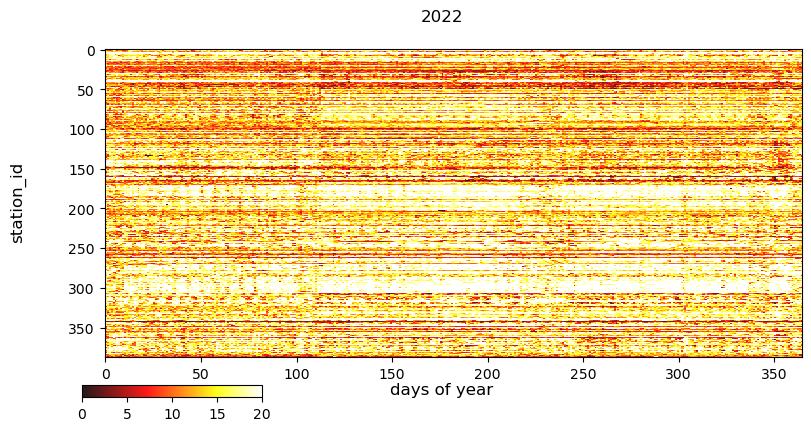

In [19]:
for year in years:
    data_filt = df_all_docks[df_all_docks['year']==year]
    vals = data_filt.groupby(['station_id','dayofyear'])['num_docks_available'].mean().unstack().clip(upper=20)
    fig, ax1 = plt.subplots(1, 1, figsize=(9, 4))
    fig.suptitle(year)
    fig.supxlabel('days of year')
    fig.supylabel('station_id')
    im = ax1.imshow(vals,cmap=plt.cm.hot,interpolation='nearest', aspect='auto',
                            alpha=.9)
    cax = fig.add_axes([0.1, 0.01, 0.2, 0.03])
    fig.colorbar(im,cax=cax,orientation='horizontal')

In general the behaviour of the stations is more similar between 21-22, than 19 and 20. Also, we observed tha there are missing values on the 19, particularly on march, which is an important month for the predcition. Also, the 20 is the covid year, and we observed some irregularities compared with the other years.   

### Predictive months
##### *Correlations stations by month, years 22-21*

In [20]:
correlations = []
for ii in metadata_sample_submissison.station_id.unique():
    G_tmp1 =df_all_docks[(df_all_docks['year']==2022) & (df_all_docks['month']==3) & (df_all_docks['station_id']==ii)].groupby(['hour'])['num_docks_available'].mean()
    G_tmp2 =df_all_docks[(df_all_docks['year']==2022) & (df_all_docks['month']==2) & (df_all_docks['station_id']==ii)].groupby(['hour'])['num_docks_available'].mean()
    correlations.append(np.corrcoef(G_tmp1,G_tmp2)[1][0])

Text(0.5, 1.0, 'Correlations of #available docks (hourly) of each station with themselves, same year, month before')

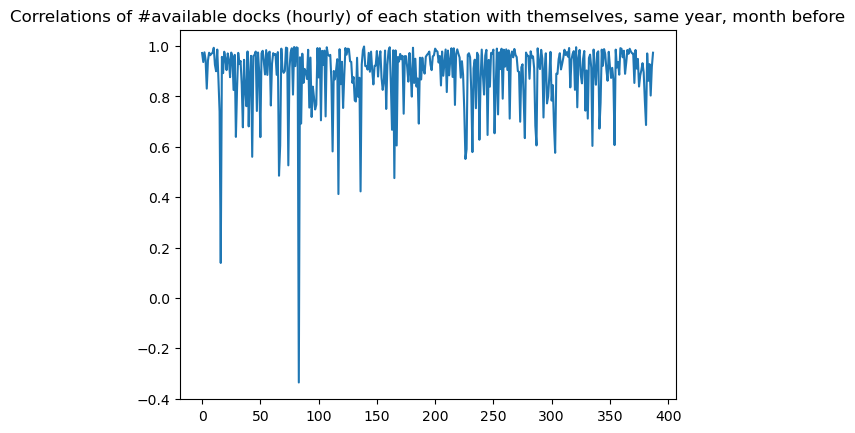

In [21]:
plt.plot(np.arange(0,len(correlations)), correlations )
plt.title('Correlations of #available docks (hourly) of each station with themselves, same year, month before')

In [22]:
correlations = []
for ii in metadata_sample_submissison.station_id.unique(): #with np.sort same as the vectorized version
    G_tmp1 =df_all_docks[(df_all_docks['year']==2022) & (df_all_docks['month']==3) & (df_all_docks['station_id']==ii)].groupby(['hour'])['num_docks_available'].mean()
    G_tmp2 =df_all_docks[(df_all_docks['year']==2021) & (df_all_docks['month']==3) & (df_all_docks['station_id']==ii)].groupby(['hour'])['num_docks_available'].mean()
    correlations.append(np.corrcoef(G_tmp1,G_tmp2)[1][0])

Text(0.5, 1.0, 'Correlations of #available docks (hourly) of each station with themselves, year before, same month')

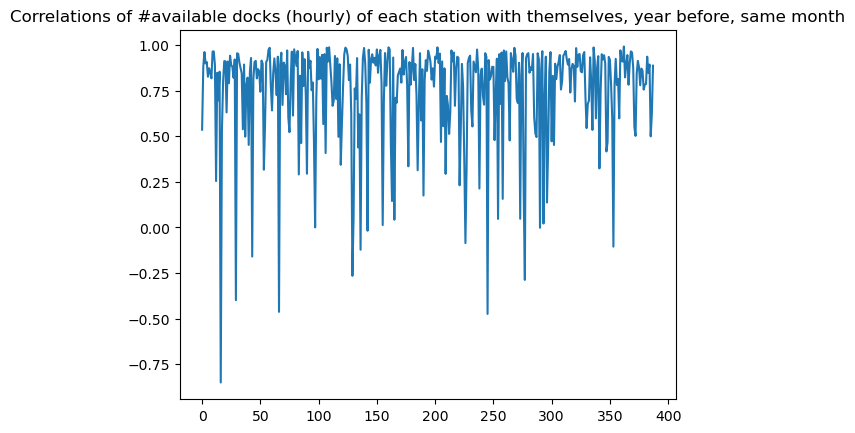

In [23]:
plt.plot(np.arange(0,len(correlations)), correlations )
plt.title('Correlations of #available docks (hourly) of each station with themselves, year before, same month')

It seems that the month before (February), same year is higher correlated with the behavior of station than the same month (March) but the year before.

### Clustering the stations

We correlated the number of docks available hourly for each station. Thus, from a matrix of 8760(hours-year) x 388(stations) we obtained a matrix correlation 388x388. In this matrix we formed a clustering to see the similarity of the stations, here we provide the clustermap of the 2021. Interestingly we observe a different cluster size which may indicate a very particular behavior. For instance, we observed a very small size (in beige) of cluster.
Then, we mapped the same nine colors in the map to identify the stations and the clusters. For instance, the beige corresponds to the bon pastor area, and they’re very few stations over there. Moreover, it is interesting to see the distributed pattern of some clusters across the city, for instance the black cluster and the pink cluster.

In [24]:
## DF date time
# Crear un rango de valores para los meses, días y horas
months = np.arange(1, 13)
days = np.arange(1, 32)
hours = np.arange(0, 24)

# Crear un DataFrame vacío con columnas "month", "day" y "hour"
df = pd.DataFrame(columns=["month", "day", "hour"])

# Llenar el DataFrame con combinaciones de meses, días y horas
for month in months:
    # Obtener el número de días correspondiente al mes
    num_days = pd.Timestamp(year=2022, month=month, day=1).days_in_month

    for day in range(1, num_days + 1):
        # Crear filas con todas las horas para cada día
        rows = pd.DataFrame({"month": [month] * 24, "day": [day] * 24, "hour": hours})
        df = pd.concat([df, rows], ignore_index=True)

In [25]:
def build_array_hours(YEAR):
  arrays_list = []
  for ii in metadata_sample_submissison.station_id.unique():
      df_temp = df_all_docks[(df_all_docks['year']==YEAR) & (df_all_docks['station_id']==ii)].groupby(['month','day','hour'])['num_docks_available'].mean()
      df_temp = pd.DataFrame(df_temp).reset_index()
      df_merged = df.merge(df_temp[['month','day', 'hour','num_docks_available']], on=['month', 'day', 'hour'], how='left')
      df_merged = df_merged.interpolate()
      arrays_list.append(df_merged.num_docks_available.values)
  array_list = pd.DataFrame(arrays_list)
  array_list = array_list.transpose()
  column_mapping = {col: new_col for col, new_col in zip(array_list.columns, metadata_sample_submissison.station_id.unique())}
  array_list.rename(columns=column_mapping, inplace=True)
  return array_list

In [26]:
#takes one min
array_list_2021 = build_array_hours(2021)
array_list_2022 = build_array_hours(2022)

In [27]:
correlation_matrix_2021 = array_list_2021.corr()
correlation_matrix_2022 = array_list_2022.corr()

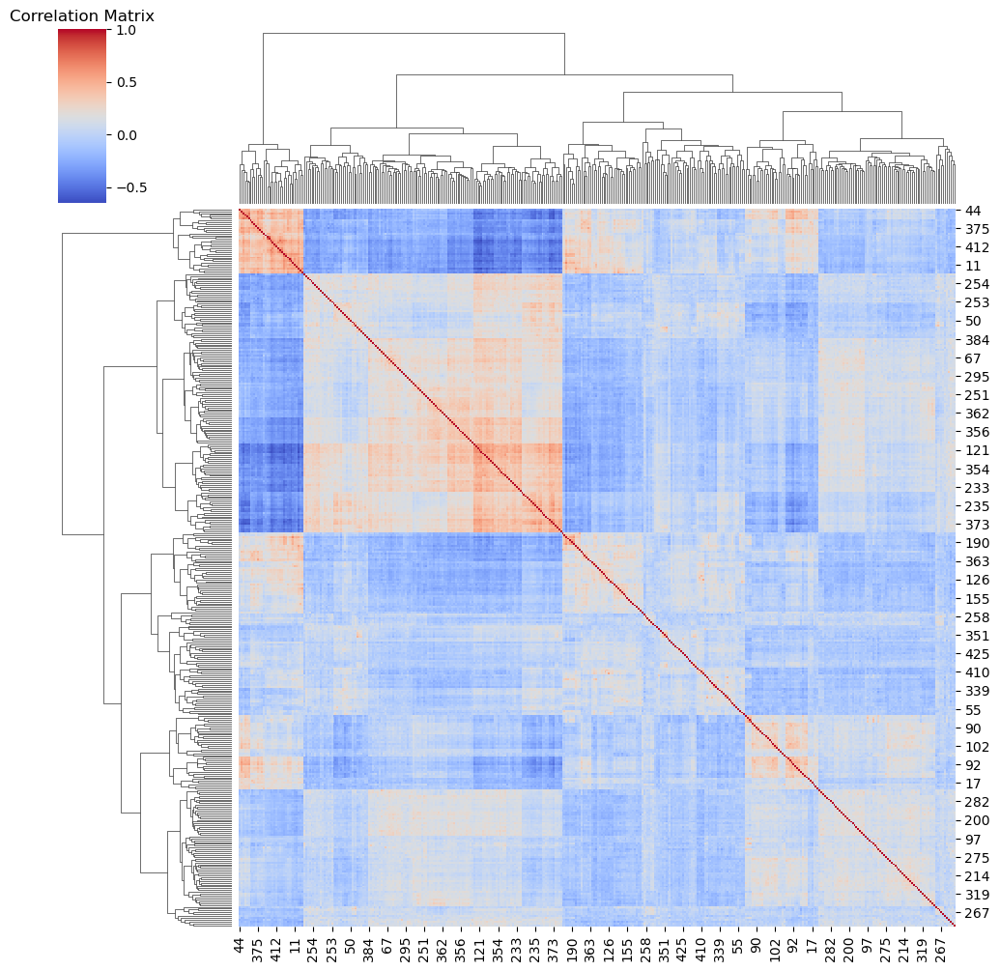

In [29]:
sns.clustermap(correlation_matrix_2021, cmap='coolwarm', fmt=".2f")
plt.title('Correlation Matrix')
plt.show()

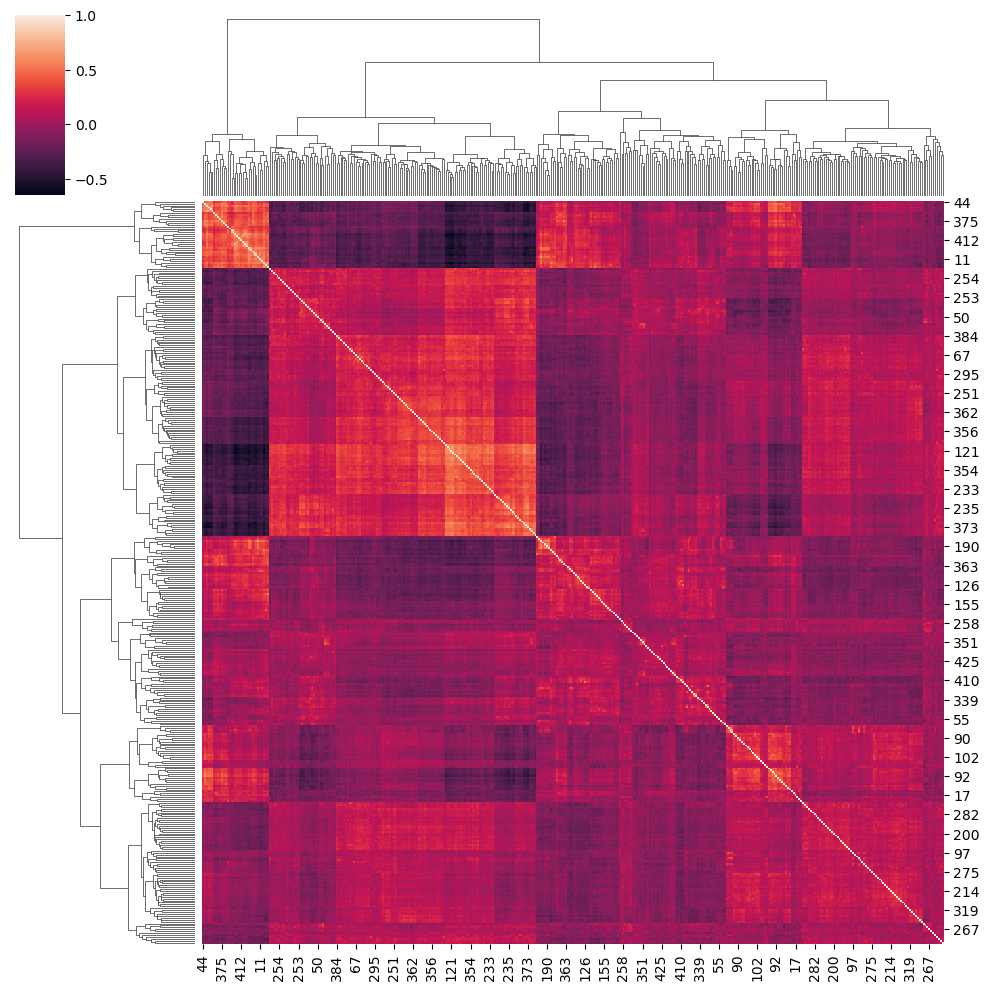

In [30]:
from scipy.cluster.hierarchy import fcluster
from scipy.cluster.hierarchy import linkage, dendrogram
clustermap = sns.clustermap(correlation_matrix_2021)
Syn_Clu_labels = clustermap.dendrogram_row.reordered_ind
Syn_Clu_Linkage_Matrix = clustermap.dendrogram_row.linkage
Syn_Clu_Assig = fcluster(Syn_Clu_Linkage_Matrix,2.75,'distance')
Syn_Order = Syn_Clu_Assig[Syn_Clu_labels] # according to the dendrogram
Syn_list_Clus = np.unique(Syn_Order)
Syn_Ind_O = np.argsort(Syn_Clu_labels)
Syn_NAME = metadata_sample_submissison.station_id.unique()[Syn_Ind_O]
# grouping the subjects according to dendrogram, let's see the four clusters
Idx_matrix=[]
Idx_ORGList=[]
for i in np.arange(1,Syn_Clu_Assig.max()+1):
    #print(i)
    AA_tmp = [i_Cl for i_Cl, x in enumerate(Syn_Order==i) if x]
    Idx_ORG = [Syn_Clu_labels[i] for i in AA_tmp]
    Idx_ORGList.append(Idx_ORG)
    Idx_matrix.append(metadata_sample_submissison.station_id.unique()[Idx_ORG])
    #print(np.transpose( Idx_ORG))
colors = sns.color_palette('Set1', len(Idx_ORGList))
color_dict = {
    1: 'lightgreen',
    2: 'pink',
    3: 'red',
    4: 'purple',
    5: 'blue',
    6: 'beige',
    7: 'darkred',
    8: 'orange',
    9: 'black'
}
df_color =  list(np.arange(0,388))
#df_color = list(df_color)
for ii in np.arange(0,Syn_Clu_Assig.max()):
    color = color_dict.get(ii+1)
    for idx in Idx_ORGList[ii]:
        df_color[idx]=color

Text(0.5, 1.0, 'Correlation between stations, pattern of hours')

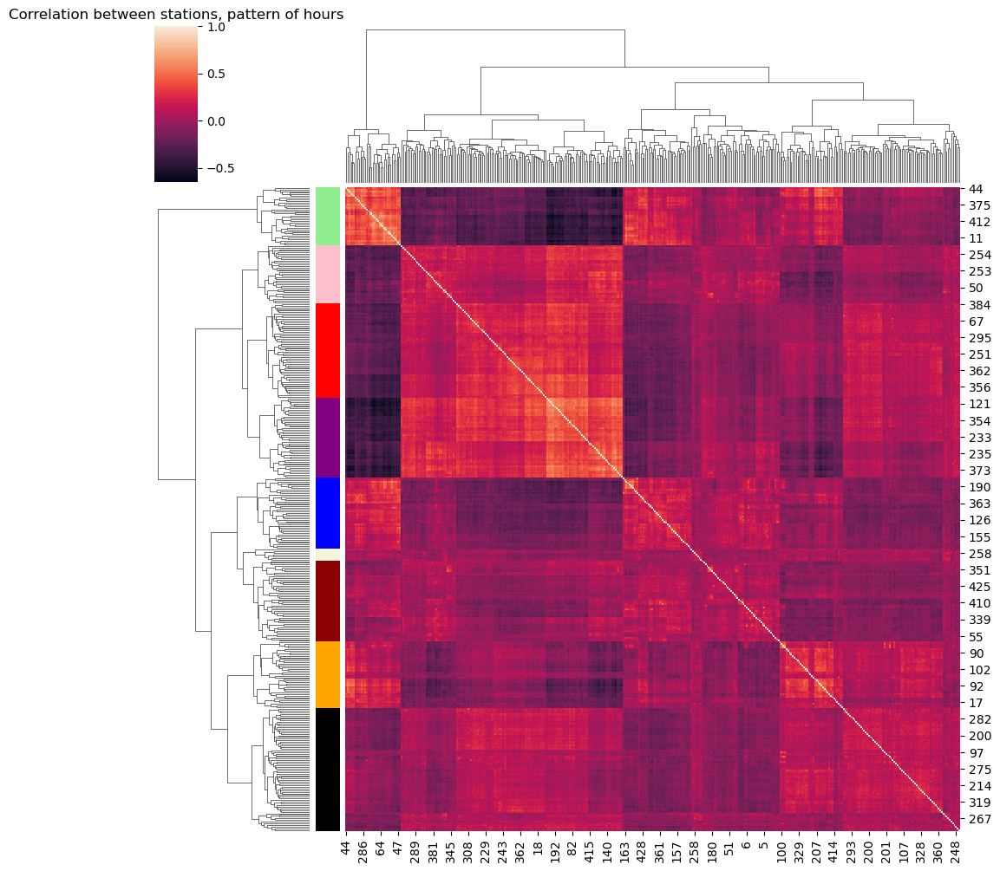

In [31]:
clustermap = sns.clustermap(correlation_matrix_2021, row_colors=df_color) # col_cluster=False,yticklabels=False,xticklabels=False)
plt.title("Correlation between stations, pattern of hours")

We found nine clusters that can be useful to classify the behaviour of the stations.

### Relationship with distances

Then, we were interested in their relationship of the distances and the patterns of num docks available. If the distance is associated with these patterns, an idea would model the behavior of the stations as a network, using network models with machine learning. The analysis revealed that distances has not related with the pattern of bike use. Also, this can be observed in the map above. For instance, we can see a distributed pattern of the black cluster across Barcelona, which cannot be explained by distance.

In [32]:
df_dist = pd.read_csv(os.path.join(folder_path,'df_dist_stations.csv'))

In [33]:
vect = np.arange(0,505)
column_mapping = {col: new_col for col, new_col in zip(df_dist.columns, vect)}
df_dist.rename(columns=column_mapping, inplace=True)
df_dist = df_dist.loc[df_dist.index.isin(metadata_sample_submissison.station_id.unique()), df_dist.columns.isin(metadata_sample_submissison.station_id.unique())]
column_mapping = {col: new_col for col, new_col in zip(df_dist.columns,  metadata_sample_submissison.station_id.unique())}
df_dist.rename(columns=column_mapping, inplace=True)
column_mapping = {col: new_col for col, new_col in zip(df_dist.index, metadata_sample_submissison.station_id.unique())}
df_dist.rename(index=column_mapping, inplace=True)

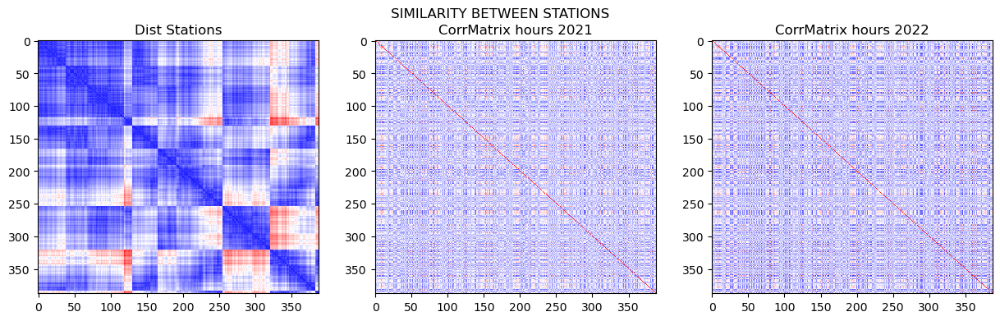

In [34]:
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(15, 4))
fig.suptitle('SIMILARITY BETWEEN STATIONS')
ax1.set_title('Dist Stations')
ax2.set_title('CorrMatrix hours 2021')
ax3.set_title('CorrMatrix hours 2022')

im1 = ax1.imshow(df_dist, cmap=plt.cm.bwr, interpolation='nearest', aspect='auto', alpha=0.9)
im2 = ax2.imshow(correlation_matrix_2021, cmap=plt.cm.bwr, interpolation='nearest', aspect='auto', alpha=0.9)
im3 = ax3.imshow(correlation_matrix_2022, cmap=plt.cm.bwr, interpolation='nearest', aspect='auto', alpha=0.9)

plt.show()

In [35]:
upper_triangular1 = np.triu(df_dist,k=1)
flatten1 = upper_triangular1.flatten()
upper_triangular2 = np.triu(correlation_matrix_2021,k=1)
flatten2 = upper_triangular2.flatten()
upper_triangular3 = np.triu(correlation_matrix_2022,k=1)
flatten3 = upper_triangular3.flatten()

In [36]:
print(np.corrcoef(flatten1, flatten2)[0, 1])
print(np.corrcoef(flatten3, flatten2)[0, 1])
print(np.corrcoef(flatten1, flatten3)[0, 1])

0.03517774798941776
0.9109666777040958
0.0313305216064865


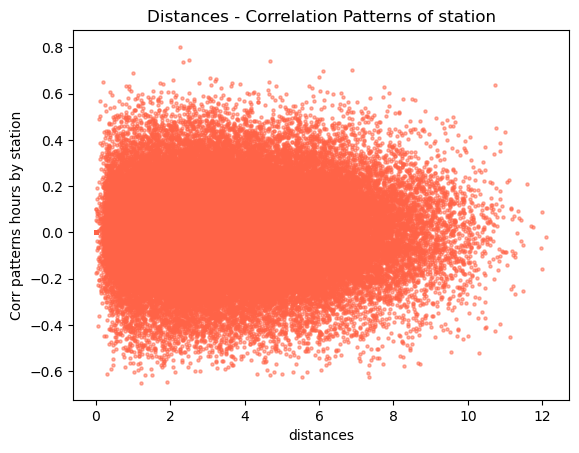

In [37]:
# Create a scatter plot
plt.scatter(flatten1, flatten2,s=5, alpha=0.5, c='tomato')
# Set plot labels and title
plt.xlabel('distances')
plt.ylabel('Corr patterns hours by station')
plt.title('Distances - Correlation Patterns of station')
# Show the plot
plt.show()

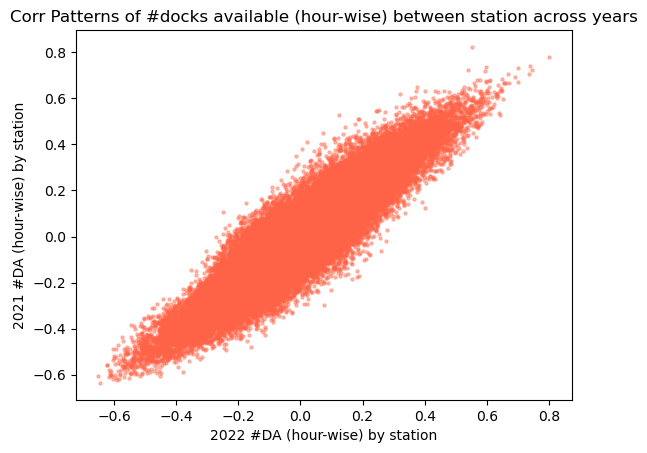

In [38]:
# Create a scatter plot
plt.scatter(flatten2, flatten3,s=5, alpha=0.4, c='tomato')
# Set plot labels and title
plt.xlabel('2022 #DA (hour-wise) by station')
plt.ylabel('2021 #DA (hour-wise) by station')
plt.title('Corr Patterns of #docks available (hour-wise) between station across years')
# Show the plot
plt.show()

It seems that distances (between stations) and the num of docks available (yearly) (between stations) are not related, but the #docks available of years 2021 and 2022 between stations is pretty similar

# **EDA "MAPS"** 

***

In this part of the EDA, we focused on the Barcelona maps, plotting data on the map. We were particularly curious on different socioeconomic variables that might be associated with the pattern of bike use. To do that, we downloaded data available in OpenDataBarcelona, and the shapefiles to generate the geopandas dataframes to create the maps.

### Libraries and loading data for MAPS

In [46]:
from scipy.io import savemat
from scipy.spatial import distance_matrix
import shapefile as shp
import geopandas as gpd
import geopy.distance
import matplotlib.pyplot as plt
import urllib.request
import zipfile
from tqdm import tqdm, trange
import datetime
import pyarrow.parquet as pq
from shapely.geometry import Polygon, Point
from descartes.patch import PolygonPatch
from pyproj import Proj
import pyproj
import folium
# from google.colab import files
import re
from folium.plugins import HeatMap, HeatMapWithTime
import networkx as nx

In [47]:
Barris = os.path.join(folder_path,'shapefiles/0301040100_Barris_UNITATS_ADM.shp')

In [48]:
map_df = gpd.read_file(Barris)

In [49]:
# Define the UTM zone and hemisphere of your data
utm_zone = '31'  # Specify your UTM zone, e.g., '31T' for zone 31 in the northern hemisphere
is_northern_hemisphere = True  # True if your data is in the northern hemisphere, False if in the southern hemisphere

# Define the UTM and WGS84 coordinate systems
utm_crs = '+proj=utm +zone={} +{} +ellps=WGS84 +datum=WGS84 +units=m +no_defs'.format(utm_zone, '+north' if is_northern_hemisphere else '+south')
wgs84_crs = 'EPSG:4326'  # WGS84 coordinate reference system

# Create a transformer object for the coordinate transformation
transformer = pyproj.Transformer.from_crs(utm_crs, wgs84_crs, always_xy=True)

map_df_conv = map_df
# Convert the geometry coordinates from UTM to longitude and latitude
map_df_conv['geometry'] = map_df_conv['geometry'].to_crs(wgs84_crs)

# Print the converted geometry coordinates, long nad latitude
print(map_df_conv['geometry'])

0     POLYGON ((2.16471 41.38593, 2.16936 41.38554, ...
1     POLYGON ((2.17701 41.38525, 2.17873 41.38396, ...
2     POLYGON ((2.19623 41.38745, 2.19631 41.38745, ...
3     POLYGON ((2.17091 41.40182, 2.17221 41.40083, ...
4     POLYGON ((2.15736 41.39331, 2.15847 41.39245, ...
                            ...                        
68    POLYGON ((2.18315 41.45279, 2.18312 41.45271, ...
69    POLYGON ((2.18872 41.45504, 2.18878 41.45484, ...
70    POLYGON ((2.18137 41.46144, 2.18173 41.46103, ...
71    POLYGON ((2.17959 41.46406, 2.17998 41.46357, ...
72    POLYGON ((2.18407 41.46830, 2.18417 41.46828, ...
Name: geometry, Length: 73, dtype: geometry


In [50]:
#selecting the columns required
df = map_df_conv[['DISTRICTE','NOM','CODI_UA','geometry']]
#renaming the column name
data_for_map = df.rename(index=str, columns={'NOM': 'NAME','DISTRICTE': 'DISTRICT' })

In [51]:
myProj = Proj("+proj=utm +zone=31 +north +ellps=WGS84 +datum=WGS84 +units=m +no_defs")

In [52]:
lon, lat = myProj(501451.286005, 4.680366e+06, inverse=True)

In [53]:
# let's try the inverse projection, long lat to UTM, worked out
CC = (42.2755, 3.0176)   #lat long, en l'alt emporda, correcte
UTMx, UTMy = myProj(CC[1], CC[0] )

In [54]:
#from shapely.measurement import total_bounds
total = pd.DataFrame(np.c_[UTMx, UTMy, CC[1], CC[0]], columns=['UTMx', 'UTMy', 'Lon', 'Lat'])
#total

In [56]:
import json
with open(os.path.join(folder_path,'download_bicis_lat_long.json') , 'r', encoding='utf-8') as f:
  JJ = json.load(f)
# Output: {'name': 'Bob', 'languages': ['English', 'French']}
print(JJ)

{'last_updated': 1684324580, 'ttl': 0, 'data': {'stations': [{'station_id': 1, 'name': 'GRAN VIA CORTS CATALANES, 760', 'physical_configuration': 'ELECTRICBIKESTATION', 'lat': 41.3979779, 'lon': 2.1801069, 'altitude': 16.0, 'address': 'GRAN VIA CORTS CATALANES, 760', 'post_code': '08013', 'capacity': 46, 'is_charging_station': True, 'nearby_distance': 1000.0, '_ride_code_support': True, 'rental_uris': None}, {'station_id': 2, 'name': 'C/ ROGER DE FLOR, 126', 'physical_configuration': 'ELECTRICBIKESTATION', 'lat': 41.3954877, 'lon': 2.1771985, 'altitude': 17.0, 'address': 'C/ ROGER DE FLOR, 126', 'post_code': '08013', 'capacity': 29, 'is_charging_station': True, 'nearby_distance': 1000.0, '_ride_code_support': True, 'rental_uris': None}, {'station_id': 3, 'name': 'C/ NÀPOLS, 82', 'physical_configuration': 'ELECTRICBIKESTATION', 'lat': 41.3941557, 'lon': 2.1813305, 'altitude': 11.0, 'address': 'C/ NÀPOLS, 82', 'post_code': '08013', 'capacity': 27, 'is_charging_station': True, 'nearby_dis

In [57]:
df_BIKES = pd.DataFrame(JJ['data']['stations'])

In [58]:
# Create a GeoDataFrame from the DataFrame with the point coordinates
point_gdf = gpd.GeoDataFrame(df_BIKES, geometry=gpd.points_from_xy(df_BIKES.lon, df_BIKES.lat))

# Perform the spatial join to count points within the geometry

number_bikes = []
for ii in range(0,73):
  df_A = gpd.GeoDataFrame(data_for_map.iloc[ii,:])
  df_A = df_A.transpose()
  df_A = df_A.set_geometry("geometry")
  points_within_geometry = gpd.sjoin(point_gdf, df_A, predicate='within') # op
  # Count the number of points within the geometry
  number_bikes.append(len(points_within_geometry))

# Print the count
print("Number of points within the geometry:", number_bikes)

Number of points within the geometry: [17, 14, 15, 34, 13, 18, 17, 5, 2, 10, 0, 16, 13, 12, 9, 4, 2, 14, 4, 0, 2, 13, 4, 8, 6, 0, 2, 0, 0, 0, 4, 0, 3, 9, 4, 6, 2, 6, 6, 5, 12, 16, 11, 8, 0, 7, 5, 1, 8, 16, 9, 4, 4, 5, 7, 10, 16, 16, 9, 7, 9, 4, 5, 0, 5, 2, 5, 1, 1, 2, 0, 1, 0]


In [59]:
len(number_bikes)
data_for_map['Number_of_Bikes'] = number_bikes

### STATIONS IN BARCELONA MAP-STATIC


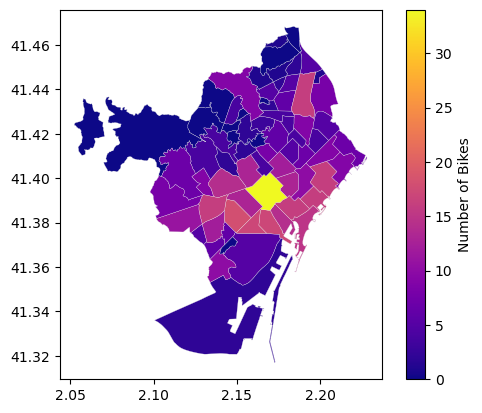

In [60]:
#just simple plot
#data_for_map.plot(column='Number_of_Bikes', cmap='BuGn', linewidth=0.2, edgecolor='0.1')

# Plot the map with the specified column and colormap
ax = data_for_map.plot(column='Number_of_Bikes', cmap='plasma', linewidth=0.2, edgecolor='0.9')
# Add a colorbar to the plot
cbar = plt.colorbar(ax.get_children()[0], ax=ax)
# Set a label for the colorbar
cbar.set_label('Number of Bikes')
# Display the plot
plt.show()

In [61]:
df_SALARY = pd.read_csv(os.path.join(folder_path,'2019_renda_disponible_llars.csv'))

In [62]:
data_for_map.dtypes

DISTRICT             object
NAME                 object
CODI_UA              object
geometry           geometry
Number_of_Bikes       int64
dtype: object

In [63]:
data_for_map['CODI_UA'] = data_for_map['CODI_UA'].astype('int32')

In [64]:
data_for_map[data_for_map['CODI_UA']==41]

,DISTRICT,NAME,CODI_UA,geometry,Number_of_Bikes
30,07,la Vall d'Hebron,41,"POLYGON ((2.15249 41.43565, 2.15252 41.43570, ...",4


In [65]:
#renaming the column name
data_for_map.rename(columns={'CODI_UA': 'Codi_Barri'}, inplace=True)

In [66]:
data_for_map = data_for_map.merge(df_SALARY, on='Codi_Barri')

In [67]:
data_for_map.drop(['NAME', 'Any'], axis=1, inplace=True)

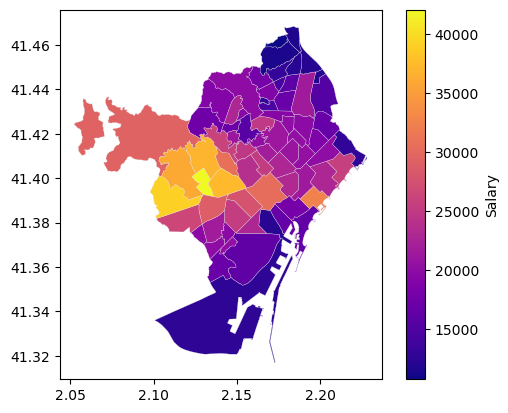

In [68]:
# Plot the map with the specified column and colormap
ax = data_for_map.plot(column='Euros_Any', cmap='plasma', linewidth=0.2, edgecolor='0.9')
# Add a colorbar to the plot
cbar = plt.colorbar(ax.get_children()[0], ax=ax)
# Set a label for the colorbar
cbar.set_label('Salary')
# Display the plot
plt.show()

In [69]:
data_for_map['Euros_Any'].corr(data_for_map['Number_of_Bikes'])

0.3506916778649639

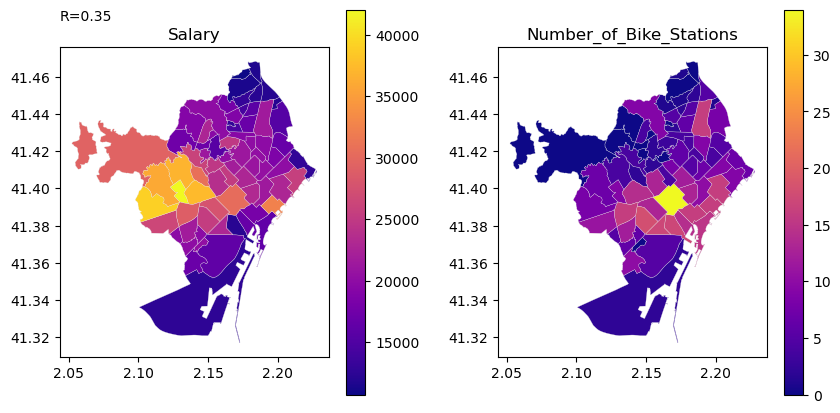

In [70]:
# Create a figure with two subplots
fig, axes = plt.subplots(1, 2, figsize=(10, 5))
# Plot the first map
ax1 = data_for_map.plot(column='Euros_Any', cmap='plasma', linewidth=0.2, edgecolor='0.9', ax=axes[0])
# Add a colorbar to the first plot
cbar1 = plt.colorbar(ax1.get_children()[0], ax=ax1)
# Set a label for the colorbar
#cbar1.set_label('Salary')
ax1.set_title('Salary')
# Add a text annotation to the first plot
ax1.text(0, 1.1, 'R=0.35', horizontalalignment='left', verticalalignment='center', transform=ax1.transAxes)


# Plot the second map
ax2 = data_for_map.plot(column='Number_of_Bikes', cmap='plasma', linewidth=0.2, edgecolor='0.9', ax=axes[1])
# Add a colorbar to the second plot
cbar2 = plt.colorbar(ax2.get_children()[0], ax=ax2)
# Set a label for the colorbar
#cbar2.set_label('Number_of_Bikes')
ax2.set_title('Number_of_Bike_Stations')
# Adjust the spacing between subplots
plt.subplots_adjust(wspace=0.3)
# Display the plot
plt.show()

#### REARRANGING DATA

In [71]:
df_SOROLL = pd.read_csv(os.path.join(folder_path,'More_Data/2017_poblacio_exposada_barris_mapa_estrategic_soroll_bcn_long.csv'))
df_MOTORITZACIO = pd.read_csv(os.path.join(folder_path, 'More_Data/2021_veh_index_motoritzacio.csv'))
df_DENSITAT = pd.read_csv(os.path.join(folder_path, 'More_Data/2021_densitat.csv'))
df_ESPE = pd.read_csv(os.path.join(folder_path, 'More_Data/2019_est_salut_publica_esp_vida.csv'))

In [72]:
df_SOROLL = df_SOROLL[df_SOROLL['Concepte']=='TOTAL_D']

In [73]:
df_SOROLL[df_SOROLL['Codi_Barri']==45]

,Codi_Districte,Nom_Districte,Codi_Barri,Nom_Barri,Concepte,Rang_soroll,Valor
440,8,Nou Barris,45,Porta,TOTAL_D,<40 dB,0.75%
441,8,Nou Barris,45,Porta,TOTAL_D,40-45 dB,21.02%
442,8,Nou Barris,45,Porta,TOTAL_D,45-50 dB,10.46%
443,8,Nou Barris,45,Porta,TOTAL_D,50-55 dB,12.03%
444,8,Nou Barris,45,Porta,TOTAL_D,55-60 dB,23.89%
445,8,Nou Barris,45,Porta,TOTAL_D,60-65 dB,17.24%
446,8,Nou Barris,45,Porta,TOTAL_D,65-70 dB,12.13%
447,8,Nou Barris,45,Porta,TOTAL_D,70-75 dB,2.48%
448,8,Nou Barris,45,Porta,TOTAL_D,75-80 dB,0.00%
449,8,Nou Barris,45,Porta,TOTAL_D,>=80 dB,0.00%


In [74]:
df_SOROLL[df_SOROLL['Codi_Barri']==45].dtypes

Codi_Districte     int64
Nom_Districte     object
Codi_Barri         int64
Nom_Barri         object
Concepte          object
Rang_soroll       object
Valor             object
dtype: object

In [75]:
string_values = df_SOROLL['Rang_soroll'].values.flatten().tolist()
print(len(string_values))
type(string_values[0])

730


str

In [76]:
perc_tg = df_SOROLL['Valor'].values.flatten().tolist()
print(len(perc_tg))
print(perc_tg[0])
type(perc_tg[0])

730
7.73%


str

In [77]:
def convert_to_int_or_mean(lst):
    new_lst = []
    for item in lst:
      if 'dB' in item:
        # Extracting the numbers using regular expressions
        numbers = re.findall(r'\d+', item)
        # Converting the numbers to integers
        numbers = [int(num) for num in numbers]
        Mean_DB = sum(numbers) / len(numbers)
        new_lst.append(Mean_DB)
      elif '%' in item:
        # Removing the percentage sign
        numeric_value = item.strip('%')
        # Converting the numeric value to a float
        numeric_value = float(numeric_value)
        new_lst.append(numeric_value)
      else:
          pass
    return new_lst

In [78]:
db_aver = convert_to_int_or_mean(string_values)

In [79]:
db_perct = convert_to_int_or_mean(perc_tg)

In [80]:
aver_pond = [a * b for a, b in zip(db_aver, db_perct)]

In [81]:
#weighted average
averages_soroll = [sum(aver_pond[i:i+10])/100 for i in range(0, len(aver_pond), 10)]
# for ii in range(0, len(aver_pond), 10):
#   sum(aver_pond[ii:ii+10])/100

In [82]:
MOTOR = []
for ii in range(1,74):
  MOTOR.append(df_MOTORITZACIO[(df_MOTORITZACIO['Codi_Barri']==ii) & (df_MOTORITZACIO['Tipus_Vehicle']=='Turismes')]['Index_Motoritzacio'].sum())

In [83]:
len(MOTOR)

73

In [84]:
df_ESPE  = df_ESPE[df_ESPE['Anys_Periode']=='2015-2019']

In [85]:
df_datas = df_ESPE.copy()

In [86]:
df_datas.drop(['Anys_Periode', 'Nom_Districte','Codi_Districte'], axis=1, inplace=True)

In [87]:
df_datas.reset_index(drop=True,inplace=True)

In [88]:
df_datas.rename(columns={'Nombre': 'LifeExpe'}, inplace=True)

In [89]:
df_datas['LifeExpe'] = df_datas['LifeExpe'].astype('float64')

In [90]:
df_datas['Motor'] = MOTOR

In [91]:
df_DENSITAT.columns

Index(['Any', 'Codi_Districte', 'Nom_Districte', 'Codi_Barri', 'Nom_Barri',
       'Població', 'Superfície (ha)', 'Superfície Residencial (ha)',
       'Densitat (hab/ha)', 'Densitat neta (hab/ha)'],
      dtype='object')

In [92]:
df_datas['Densitat'] = df_DENSITAT['Densitat neta (hab/ha)']

In [93]:
df_datas['Soroll'] = averages_soroll

In [94]:
df_datas

,Codi_Barri,Nom_Barri,LifeExpe,Motor,Densitat,Soroll
0,1,el Raval,81.6,2532.72,952,52.63725
1,2,el Barri Gòtic,82.5,2641.70,639,53.56575
2,3,la Barceloneta,80.5,2225.07,1081,53.56075
3,4,"Sant Pere, Santa Caterina i la Ribera",83.5,2198.93,683,52.67400
4,5,el Fort Pienc,84.7,5346.73,930,59.52925
...,...,...,...,...,...,...
68,69,Diagonal Mar i el Front Marítim del Poblenou,85.9,2092.30,556,59.37850
69,70,el Besòs i el Maresme,84.5,3187.33,913,53.32325
70,71,Provençals del Poblenou,85.1,3762.88,1368,58.55950
71,72,Sant Martí de Provençals,85.8,5288.91,1111,55.49875


### STATIC PLOT BARCELONA

The variables used were salaries, life expectancy, the index of motorization, population density and the level of noise. It is interesting to see how the higher life expectancy is associated with higher salary, particularly in the north of Barcelona. Also, we see that the neighborhoods with higher noise, are those with higher number of bike stations, and with higher motorization index.
Also, we performed a correlation of those variables with the bike use.

In [95]:
data_for_map = data_for_map.merge(df_datas, on='Codi_Barri')

In [96]:
data_for_map.drop(['Nom_Barri_y','DISTRICT'], axis=1, inplace=True)

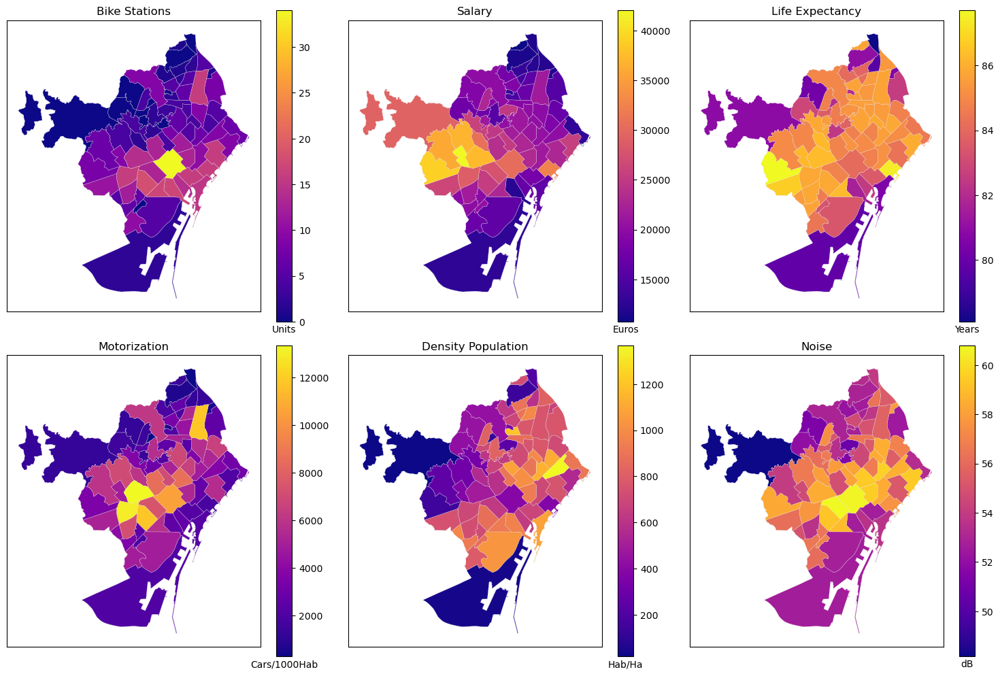

In [97]:
# Create the subplots
fig, axes = plt.subplots(2, 3, figsize=(15, 10))
variables = ['Number_of_Bikes','Euros_Any', 'LifeExpe', 'Motor', 'Densitat', 'Soroll']
titles= ['Bike Stations', 'Salary','Life Expectancy','Motorization', 'Density Population', 'Noise']
units = ['Units','Euros','Years','Cars/1000Hab','Hab/Ha','dB']
# Iterate over the variables and plot them
for i, variable in enumerate(variables):
    # Calculate the subplot position
    row = i // 3  # Integer division for row index
    col = i % 3   # Modulo operation for column index
    # Plot the map on the current subplot
    ax = data_for_map.plot(column=variable, cmap='plasma', linewidth=0.2, edgecolor='0.9', ax=axes[row, col])

    # Add a colorbar to the plot
    cbar = plt.colorbar(ax.get_children()[0], ax=ax)
    # Set a label for the colorbar
    #cbar.set_label(units[i])
    # Position the colorbar label horizontally below the colorbar
    cbar.ax.xaxis.set_label_coords(0.5, -0.01)
    cbar.ax.set_xlabel(units[i], rotation=0)

    # Set a title for the subplot
    ax.set_title(titles[i])
    ax.set_xticks([])
    ax.set_yticks([])
# Adjust the layout of the subplots
plt.tight_layout()
# Display the plot
plt.show()

In [98]:
def plot_matrix(matrix):
    fig = plt.figure(figsize=(28, 28))
    plt.matshow(matrix,cmap='jet')
    cbar_ax = fig.add_axes([0.01, 0.1, 0.1, 0.01])
    cbar = plt.colorbar(cax=cbar_ax, orientation='horizontal', pad=0.05)
    plt.show()


In [99]:
vars = ['Number_of_Bikes', 'Euros_Any', 'LifeExpe', 'Motor',
       'Densitat', 'Soroll']
matrix_CORR = data_for_map[vars].corr()

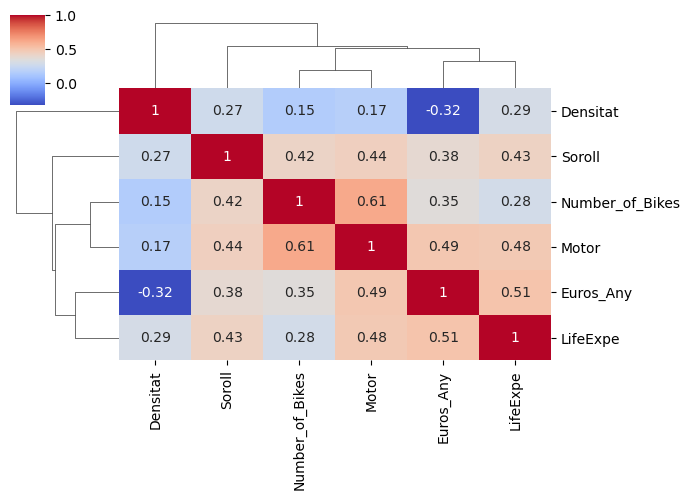

In [100]:
sns.clustermap(matrix_CORR,metric="correlation", annot= True,cmap="coolwarm", figsize=(7, 5) )

It seems that the number of cycle stations per neighbor is correlated with the motorization index, the rest of the variables are moderately correlated. Interestingly, high density neighbors are negatively correlated with salaries, and show low correlation with bikes, where might be needed.

### INTERACTIVE MAP

We generated an interactive map where we could display all these variables on the Barcelona map, we generated this using a combination of folium libraries and geopandas:

In [101]:
vector_name = [ii for ii in range(0,73)]

In [102]:
data_for_map['vect'] = vector_name

In [103]:
# Specify the center coordinates of the map
map_center = [41.3979779, 2.1801069]

# Create the folium map
m = folium.Map(location=map_center, zoom_start=12)

# Add OpenStreetMap as a tile layer
folium.TileLayer('CartoDB dark_matter').add_to(m)
folium.TileLayer('Stamen Toner').add_to(m)
folium.TileLayer('stamenwatercolor').add_to(m)
#folium.TileLayer('MapQuest Open Aerial').add_to(m)
#folium.TileLayer('Mapbox Control Room').add_to(m)
folium.TileLayer('openstreetmap').add_to(m)
folium.TileLayer('Stamen Terrain').add_to(m)

# Add the GeoPandas data to the folium map
folium.Choropleth(
    geo_data=data_for_map,
    name="Stations (units)",
    data=data_for_map,
    columns=["vect", "Number_of_Bikes"],
    key_on="feature.id",
    fill_color="BuGn",
    fill_opacity=0.3,
    line_opacity=1,
    legend_name="Number of Stations",
    overlay = True,
    highlight=True  # Enable highlighting when hovering over areas
).add_to(m)

# Add a second choropleth with different columns
folium.Choropleth(
    geo_data=data_for_map,
    name="Salary (euros)",
    data=data_for_map,
    columns=["vect", "Euros_Any"],  # Specify the columns for the second choropleth
    key_on="feature.id",
    fill_color="BuGn", #"YlGn",
    fill_opacity=0.3,
    line_opacity=1,
    legend_name="Salary",
    highlight=True  # Enable highlighting when hovering over areas
).add_to(m)

folium.Choropleth(
    geo_data=data_for_map,
    name="Life Expectancy (years)",
    data=data_for_map,
    columns=["vect", "LifeExpe"],
    key_on="feature.id",
    fill_color="BuGn", #"OrRd",
    fill_opacity=0.3,
    line_opacity=1,
    legend_name="Life Expectancy",
    highlight=True  # Enable highlighting when hovering over areas
).add_to(m)

folium.Choropleth(
    geo_data=data_for_map,
    name="Motor (Cars per 1000 ppl)",
    data=data_for_map,
    columns=["vect", "Motor"],
    key_on="feature.id",
    fill_color="BuGn", #"OrRd",
    fill_opacity=0.3,
    line_opacity=1,
    legend_name="Cars/1000",
    highlight=True  # Enable highlighting when hovering over areas
).add_to(m)

folium.Choropleth(
    geo_data=data_for_map,
    name="Density (Ppl/Ha)",
    data=data_for_map,
    columns=["vect", "Densitat"],
    key_on="feature.id",
    fill_color="BuGn", #"OrRd",
    fill_opacity=0.3,
    line_opacity=1,
    legend_name="Population Density",
    highlight=True  # Enable highlighting when hovering over areas
).add_to(m)

folium.Choropleth(
    geo_data=data_for_map,
    name="Noise(dB)",
    data=data_for_map,
    columns=["vect", "Soroll"],
    key_on="feature.id",
    fill_color="BuGn", #"OrRd",
    fill_opacity=0.3,
    line_opacity=1,
    legend_name="Nosie dB",
    highlight=True  # Enable highlighting when hovering over areas
).add_to(m)

# Add a popup for each area
folium.GeoJson(
    data_for_map,
    name="popup_layer",
    style_function=lambda feature: {
        'fillOpacity': 0,
        'weight': 0,
        #'color': 'black',
    },
    highlight_function=lambda feature: {
        'fillOpacity': 0.3
    },
    tooltip=folium.features.GeoJsonTooltip(
        fields=["Nom_Barri_x", "Number_of_Bikes", "Euros_Any", "LifeExpe","Motor","Densitat",	"Soroll"],
        aliases=["Neighbor", "Number of Stations", "Salary", "Life Expectancy","Motor Index", "Population Density","DB"],
        localize=True, style=("background-color: rgba(255, 255, 255, 0.3); color: rgba(0, 0, 0, 1);")
    )
).add_to(m)

folium.LayerControl().add_to(m)
m

In [104]:
df_all_docks['timestamp'] = pd.to_datetime(df_all_docks['last_reported'])

In [105]:
# station_id to barri, look where is the station
df_GEO = pd.DataFrame(columns=['station_id', 'lat', 'lon', 'geometry', 'Codi_Barri'])
for ii in range(0, 73):
    df_A = gpd.GeoDataFrame(data_for_map.iloc[ii, :])
    df_A = df_A.transpose()
    df_A = df_A.set_geometry("geometry") # POINT
    df_P_G = gpd.sjoin(point_gdf, df_A, predicate='within') #
    df_P_G = df_P_G[['station_id', 'lat', 'lon', 'geometry', 'Codi_Barri','Nom_Barri_x','Nom_Districte','Codi_Districte','capacity']] # geometry of the point, polygon
    df_GEO = pd.concat([df_GEO, df_P_G], ignore_index=True)
del df_P_G, df_A

### DYNAMIC PLOT

Moreover, we created static and dynamic heatmaps, that allow us to observe the evolution of the bikes hourly, we also selected specific days as Christmas to see if the pattern was extremely different. That help us to consider it when modelling.

In [106]:
df_all_docks['year'] = df_all_docks['timestamp'].dt.year

In [107]:
#grouping by day
YEAR = 2020
day_Christmas     = df_all_docks[(df_all_docks['year']==YEAR) & (df_all_docks['day']==25) & (df_all_docks['month']==12)]
day_Sant_Jordi    = df_all_docks[(df_all_docks['year']==YEAR) & (df_all_docks['day']==23) & (df_all_docks['month']==4)]
day_Sant_Joan     = df_all_docks[(df_all_docks['year']==YEAR) & (df_all_docks['day']==24) & (df_all_docks['month']==6)]
day_winter        = df_all_docks[(df_all_docks['year']==YEAR) & (df_all_docks['day']==15) & (df_all_docks['month']==1)]
day_summer        = df_all_docks[(df_all_docks['year']==YEAR) & (df_all_docks['day']==9) & (df_all_docks['month']==7)]

In [108]:
#grouping by year, hourly
YEAR=2022
G_by_year = df_all_docks[(df_all_docks['year']==YEAR)].groupby(['station_id','hour']).mean(numeric_only=True).drop(['month','day','year','num_docks_available'],axis=1).reset_index()

# G_SU_TS = df_categoricals_TS.groupby('Suburb').agg({'CouncilArea': 'count','Long': 'mean','Lat': 'mean'})

In [109]:
#grouping by year and season(winter vs summer), hourly
YEAR=2022
MONTHS_W=[12,1,2] # winter
MONTHS_S=[6,7,8] # summer
G_by_year_season = df_all_docks[(df_all_docks['year']==YEAR) & (df_all_docks['month'].isin(MONTHS_S))].groupby(['station_id','hour']).mean(numeric_only=True).drop(['month','day','year','num_docks_available'],axis=1).reset_index()


In [110]:
def make_heat_map(df):
  heat_data = []
  heat_data_all = []
  index_TS =[]
  #MAX_BIKES = df['num_bikes_available'].max()
  for ii in range(0,24):
    df_tmp = df[df['hour']==ii]
    #MAX_BIKES = df['num_bikes_available'].max()
    for _, row in df_tmp.iterrows():
        lon = row['lon']
        lat = row['lat']
        bikes = row['num_bikes_available']/row['capacity']   #MAX_BIKES  # row['num_bikes_available'].max() #100
        # timestamp = row['hour']
        heat_data.append([lat, lon, bikes])
    heat_data_all.append(heat_data)
    heat_data=[]
    if 'timestamp' in df.columns:
      index_TS.append(df_tmp['timestamp'].dt.strftime('%Y-%m-%d %H:%M:%S').iloc[0])
    else :
      pass
  if not index_TS:
    index_TS = [i for i in range(0, 24)]
  else:
    pass
  return heat_data_all, index_TS

In [111]:
heat_data_dynamic, index_TS =  make_heat_map(G_by_year_season)

In [112]:
# Specify the center coordinates of the map
map_center = [41.3979779, 2.1801069]

# Create the folium map
m = folium.Map(location=map_center, zoom_start=12)
folium.TileLayer('CartoDB dark_matter').add_to(m)
folium.TileLayer('stamentoner').add_to(m)

# Add the GeoPandas data to the folium map
folium.Choropleth(
    geo_data=data_for_map,  name="Stations (units)", data=data_for_map,      columns=["vect", "Number_of_Bikes"],
    key_on="feature.id",    fill_color="BuGn",       fill_opacity=0.3,       line_opacity=1,
    legend_name="Number of Stations",                overlay = True,         highlight=True
).add_to(m)

# Create the HeatMapWithTime layer with the heat_data
heat_map = HeatMapWithTime(heat_data_dynamic,index=index_TS, radius=15)
heat_map.add_to(m)

# # Add a popup for each area
folium.GeoJson(
    data_for_map,
    name="popup_layer",
    style_function=lambda feature: {
        'fillOpacity': 0,
        'weight': 0,
        #'color': 'black',
    },
    highlight_function=lambda feature: {
        'fillOpacity': 0.3
    },
    tooltip=folium.features.GeoJsonTooltip(
        fields=["Nom_Barri_x", "Number_of_Bikes", "Euros_Any", "LifeExpe","Motor","Densitat",	"Soroll"],
        aliases=["Neighbor", "Number of Stations", "Salary", "Life Expectancy","Motor Index", "Population Density","DB"],
        localize=True, style=("background-color: rgba(255, 255, 255, 0.3); color: rgba(0, 0, 0, 1);")
    )
).add_to(m)

folium.LayerControl().add_to(m)
# Display the map
m

In [114]:
map_center = [41.3979779, 2.1801069]
m = folium.Map(location=map_center, zoom_start=12)
#folium.TileLayer('stamentoner').add_to(m)

def map_static(df):
  heat_data = []
  MAX_B = df['num_bikes_available'].max()
  for _, row in df.iterrows():
      lon = row['lon']
      lat = row['lat']
      bikes = row['num_bikes_available']/MAX_B
      heat_data.append([lat, lon, bikes ])
  return heat_data

heat_data = map_static(day_Christmas)
heat_map = HeatMap(heat_data, radius=15)
heat_map.add_to(m)
m

In [115]:
df_CATEGORICAL = pd.read_csv(os.path.join(folder_path,'df_categorical.csv'))

In [116]:
# Create a map
map_center = [41.3979779, 2.1801069]
map = folium.Map(location=map_center, zoom_start=12)

category_colors = {
    1: 'lightgreen',
    2: 'pink',
    3: 'red',
    4: 'purple',
    5: 'blue',
    6: 'beige',
    7: 'darkred',
    8: 'orange',
    9: 'black'
}
# Iterate over the data and add markers to the map
for _, row in df_CATEGORICAL.iterrows():
    color = category_colors.get(row['nine_clusters'], 'blue')  # Use 'blue' as a default color for unknown categories
    folium.Marker(location=[row['lat'], row['lon']] , icon=folium.Icon(color=color)).add_to(map)
map

This colors correspond to the clustermap done before, where the similarity of stations is based on the pattern of num of available docks, hourly during the year. For instance, see how the beige stations have a very particular pattern, and represente a small cluster in the clustermap. We can see in the map that they correspond to. the area of "bon partor" in the north. Just see below

Text(0.5, 1.0, 'Correlation between stations, pattern of hours')

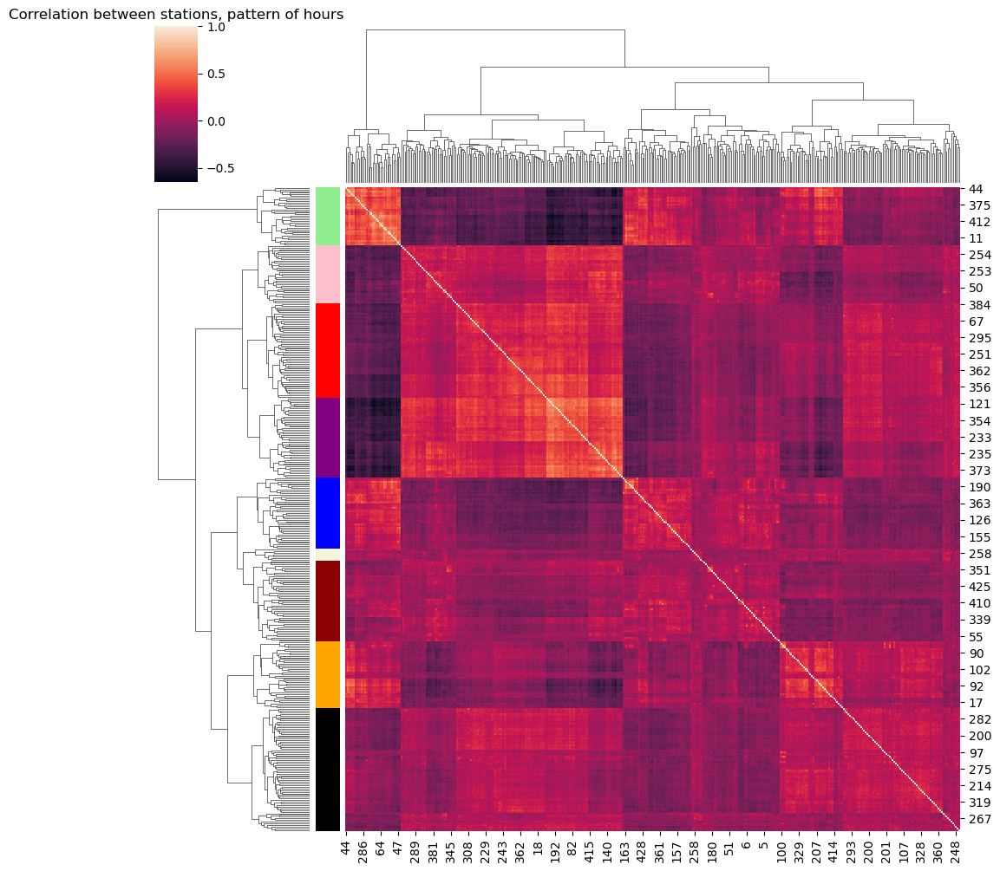

In [117]:
clustermap = sns.clustermap(correlation_matrix_2021, row_colors=df_color) # col_cluster=False,yticklabels=False,xticklabels=False)
plt.title("Correlation between stations, pattern of hours")

### Stations as nodes of a network

In [118]:
## works, too long
coords = df_GEO[['lat', 'lon']].values
dist_stations = np.zeros((len(coords), len(coords)))

for ii in range(0,len(coords)):
  coords_1 = (coords[ii][0],	coords[ii][1])
  for jj in range(0,len(coords)):
    coords_2 = (coords[jj][0],	coords[jj][1])
    dist_stations[ii, jj] = geopy.distance.geodesic(coords_1, coords_2).km


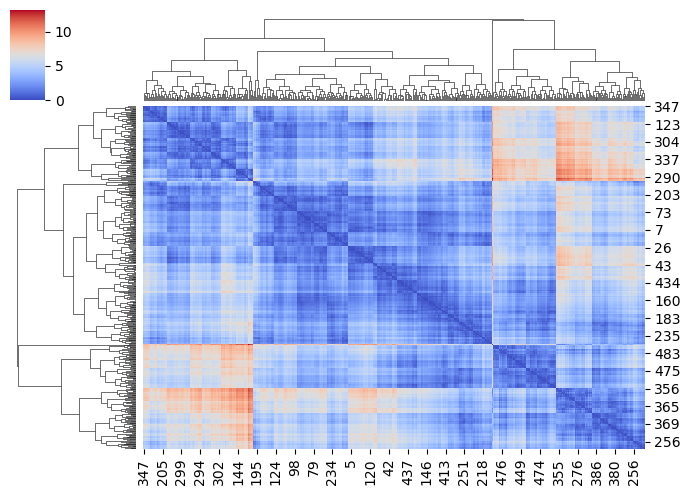

In [119]:
sns.clustermap(dist_stations,metric="euclidean",cmap="coolwarm", figsize=(7, 5) )

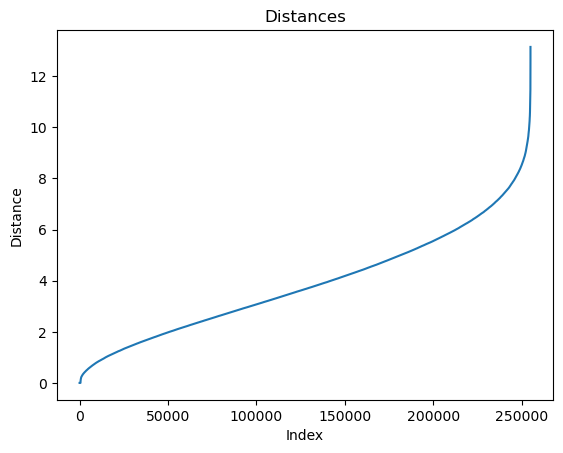

In [120]:
# Flatten the arrays into a single 1D array
flattened_array = np.sort(np.concatenate(dist_stations))
# Create x-values for the plot
x = np.arange(len(flattened_array))
# Plot the values
plt.plot(x, flattened_array)
# Add labels and title
plt.xlabel('Index')
plt.ylabel('Distance')
plt.title('Distances')
# Show the plot
plt.show()
# plt.plot(dist_stations) #all the rows separetely

In [121]:
df_GEO['node'] =  [ii for ii in range(0,505)]

In [122]:
G = nx.Graph()
num_nodes = len(dist_stations)
G.add_nodes_from(range(num_nodes))

for i in range(num_nodes):
    for j in range(i + 1, num_nodes):
        if dist_stations[i][j] >= 9.5:  # Filter condition based on your requirement
            G.add_edge(i, j)

In [123]:
G.remove_nodes_from(list(nx.isolates(G)))

In [124]:
nodes_graph = set(list(G.nodes()))


In [125]:
df_filtered = df_GEO[df_GEO['node'].isin(nodes_graph)]

In [126]:
partition = df_filtered['Nom_Districte']
# # Define a color map for the partition, district to color
color_map = {'Ciutat Vella': 'red', 'Eixample': 'blue', 'Sants-Montjuïc': 'green','Horta-Guinardó': 'sienna', 'Nou Barris': 'orange',
               'Sant Andreu': 'magenta','Les Corts':'tomato', 'Sant Martí':'cyan'} #5: 'purple',6: 'cyan',

# # Get the node colors based on the partition
node_colors = [color_map[partition[node]] for node in G.nodes()]
node_sizes = df_filtered['capacity']*5

As we commented above, we were interested in the distance of the stations to model them as a network. We explore the network of the stations at different distances (Euclidian, not topological because it wasn´t available). Just to see different patterns:

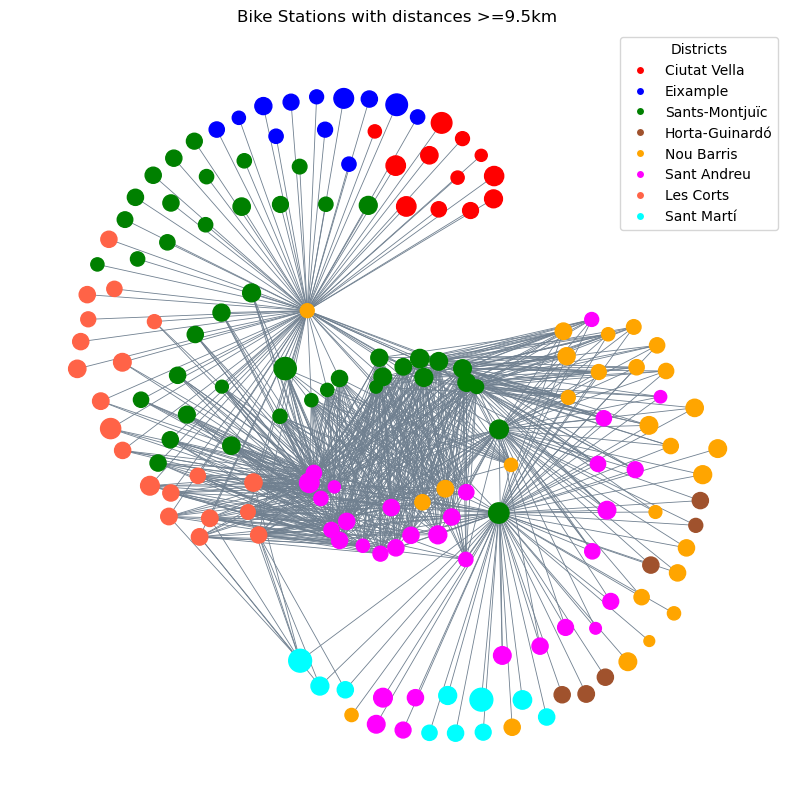

In [127]:
#plt.rcParams['figure.facecolor'] = 'black'
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(10, 10))
ax.set_facecolor('black')
#plt.figure(facecolor='tomato')
#fig.set_facecolor('tomato')
nx.draw_kamada_kawai(G,node_color=node_colors,node_size=node_sizes,edge_color='slategray',width=0.6, with_labels=False,ax=ax) # networkx, draw_kamada_kawai, draw_spring
legend_elements = [plt.Line2D([0], [0], marker='o', color='w', label=name, markerfacecolor=color)
                   for name, color in color_map.items()]
plt.legend(handles=legend_elements, title='Districts')
plt.title('Bike Stations with distances >=9.5km', color='black')
plt.show()

Using these networks, we could observe the distribution of the bike stations by ‘District’, and may perform some analysis in the network using graph theory.

In [128]:
G = nx.Graph()
num_nodes = len(dist_stations)
G.add_nodes_from(range(num_nodes))

## INTRODUCE THE DISTANCE (KM)
MIN = 1.5
MAX = 2.25

for i in range(num_nodes):
    for j in range(i + 1, num_nodes):
        if (dist_stations[i][j] >= MIN) & (dist_stations[i][j] <= MAX) :  # Filter condition based on your requirement
        #if (dist_stations[i][j] <= 0.5) :  # Filter condition based on your requirement
            G.add_edge(i, j)

G.remove_nodes_from(list(nx.isolates(G)))
nodes_graph = set(list(G.nodes()))
df_filtered = df_GEO[df_GEO['node'].isin(nodes_graph)]
df_filtered['Nom_Districte'].unique()



array(['Ciutat Vella', 'Eixample', 'Sants-Montjuïc',
       'Sarrià-Sant Gervasi', 'Gràcia', 'Horta-Guinardó', 'Nou Barris',
       'Les Corts', 'Sant Andreu', 'Sant Martí'], dtype=object)

In [129]:
partition = df_filtered['Nom_Districte']
# # Define a color map for the partition, district to color
color_map = {'Ciutat Vella': 'lightblue', 'Eixample': 'blue', 'Sants-Montjuïc': 'green','Horta-Guinardó': 'sienna', 'Nou Barris': 'orange',
               'Sant Andreu': 'magenta','Les Corts':'tomato', 'Sant Martí':'cyan','Sarrià-Sant Gervasi': 'purple', 'Gràcia': 'khaki'}

# # Get the node colors based on the partition
node_colors = [color_map[partition[node]] for node in G.nodes()]
node_sizes = df_filtered['capacity']*5

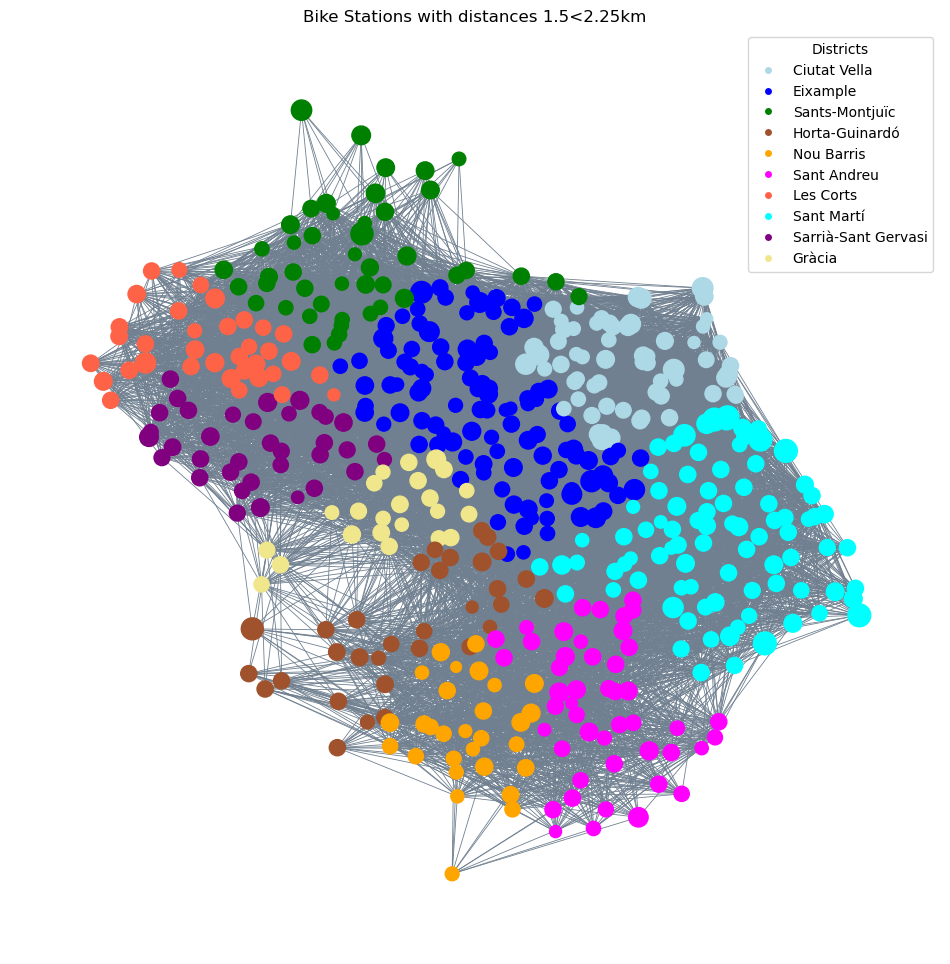

In [130]:
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(12, 12))
ax.set_facecolor('black')
#plt.figure(facecolor='tomato')
#fig.set_facecolor('tomato')
nx.draw_kamada_kawai(G,node_color=node_colors,node_size=node_sizes,edge_color='slategray',width=0.6, with_labels=False,ax=ax) # networkx, draw_kamada_kawai, draw_spring
legend_elements = [plt.Line2D([0], [0], marker='o', color='w', label=name, markerfacecolor=color)
                   for name, color in color_map.items()]
plt.legend(handles=legend_elements, title='Districts')
plt.title(f"Bike Stations with distances {MIN}<{MAX}km", color='black')
plt.show()